<h1><center>Pattern Mining - Anh Thu</center></h1>

## Correlation mining

In [1]:
from string import ascii_letters
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
df1 = pd.read_csv('Data sets/nba.csv')
df1.head()

,PLAYER,TEAM,AGE,GP,W,L,MIN,PTS,FGM,FGA,...,REB,AST,TOV,STL,BLK,PF,FP,DD2,TD3,X...
0,Aaron Gordon,ORL,23,78,40,38,33.8,16.0,6.0,13.4,...,7.4,3.7,2.1,0.7,0.7,2.2,32.6,19,0,1.4
1,Aaron Holiday,IND,22,50,31,19,12.9,5.9,2.1,5.2,...,1.3,1.7,0.8,0.4,0.3,1.4,11.3,0,0,2.0
2,Abdel Nader,OKC,25,61,38,23,11.4,4.0,1.5,3.5,...,1.9,0.3,0.4,0.3,0.2,1.1,7.9,0,0,-2.5
3,Al Horford,BOS,32,68,41,27,29.0,13.6,5.7,10.6,...,6.7,4.2,1.5,0.9,1.3,1.9,32.8,10,1,3.8
4,Al-Farouq Aminu,POR,28,81,52,29,28.3,9.4,3.2,7.3,...,7.5,1.3,0.9,0.8,0.4,1.8,23.2,12,0,4.7


In [3]:
df1.columns

Index(['PLAYER', 'TEAM', 'AGE', 'GP', 'W', 'L', 'MIN', 'PTS', 'FGM', 'FGA',
       'FG.', 'X3PM', 'X3PA', 'X3P.', 'FTM', 'FTA', 'FT.', 'OREB', 'DREB',
       'REB', 'AST', 'TOV', 'STL', 'BLK', 'PF', 'FP', 'DD2', 'TD3', 'X...'],
      dtype='object')

<AxesSubplot:>

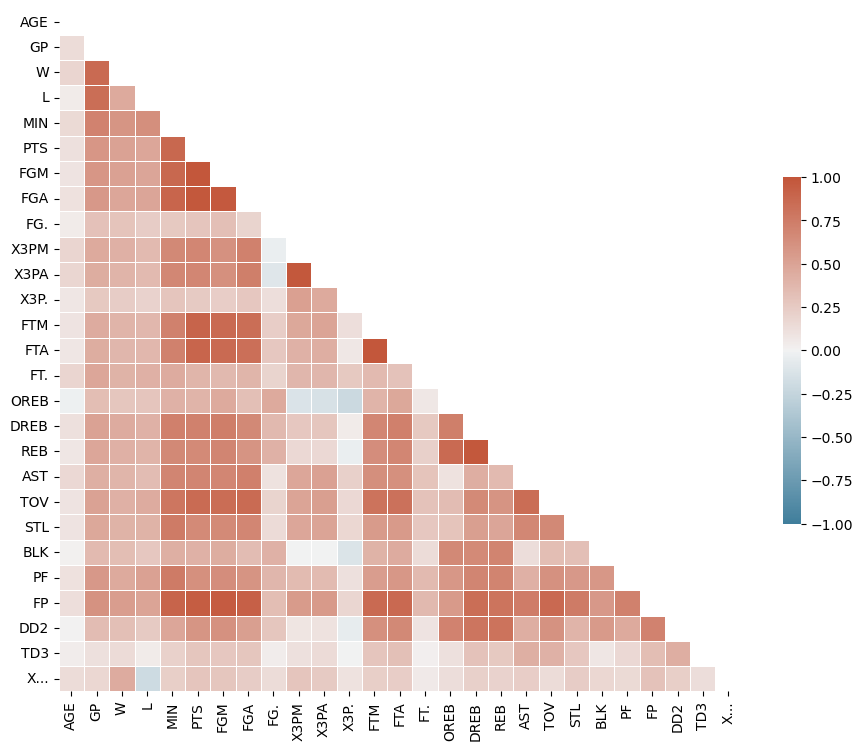

In [4]:
corr = df1.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [5]:
#pip install pingouin
import pingouin as pg

In [6]:
df1.rcorr()

,AGE,GP,W,L,MIN,PTS,FGM,FGA,FG.,X3PM,...,REB,AST,TOV,STL,BLK,PF,FP,DD2,TD3,X...
AGE,-,**,***,,***,*,*,*,,***,...,,***,*,*,,*,**,,,**
GP,0.138,-,***,***,***,***,***,***,***,***,...,***,***,***,***,***,***,***,***,*,***
W,0.185,0.867,-,***,***,***,***,***,***,***,...,***,***,***,***,***,***,***,***,**,***
L,0.044,0.84,0.457,-,***,***,***,***,***,***,...,***,***,***,***,***,***,***,***,,***
MIN,0.152,0.71,0.589,0.626,-,***,***,***,***,***,...,***,***,***,***,***,***,***,***,***,***
PTS,0.11,0.579,0.507,0.479,0.881,-,***,***,***,***,...,***,***,***,***,***,***,***,***,***,***
FGM,0.091,0.584,0.509,0.487,0.882,0.99,-,***,***,***,...,***,***,***,***,***,***,***,***,***,***
FGA,0.103,0.568,0.48,0.489,0.893,0.982,0.977,-,***,***,...,***,***,***,***,***,***,***,***,***,***
FG.,0.046,0.312,0.291,0.239,0.259,0.282,0.327,0.193,-,,...,***,*,***,***,***,***,***,***,,**
X3PM,0.187,0.457,0.419,0.359,0.67,0.68,0.617,0.715,-0.031,-,...,***,***,***,***,,***,***,,**,***


In [7]:
# Bonferonni
pg.pairwise_corr(df1, method="pearson", padjust = "bonf").head()

,X,Y,method,alternative,n,r,CI95%,p-unc,p-corr,p-adjust,BF10,power
0,AGE,GP,pearson,two-sided,530,0.137651,"[0.05, 0.22]",0.001490,0.523003,bonf,8.332,0.889323
1,AGE,W,pearson,two-sided,530,0.184775,"[0.1, 0.27]",0.000019,0.006539,bonf,505.385,0.990225
2,AGE,L,pearson,two-sided,530,0.044418,"[-0.04, 0.13]",0.307415,1.000000,bonf,0.091,0.175322
3,AGE,MIN,pearson,two-sided,530,0.152169,"[0.07, 0.23]",0.000439,0.154118,bonf,25.804,0.941053
4,AGE,PTS,pearson,two-sided,530,0.110078,"[0.03, 0.19]",0.011215,1.000000,bonf,1.344,0.718863


In [8]:
# Holm
pg.pairwise_corr(df1, method="pearson", padjust = "holm").head()

,X,Y,method,alternative,n,r,CI95%,p-unc,p-corr,p-adjust,BF10,power
0,AGE,GP,pearson,two-sided,530,0.137651,"[0.05, 0.22]",0.001490,0.081952,holm,8.332,0.889323
1,AGE,W,pearson,two-sided,530,0.184775,"[0.1, 0.27]",0.000019,0.001360,holm,505.385,0.990225
2,AGE,L,pearson,two-sided,530,0.044418,"[-0.04, 0.13]",0.307415,1.000000,holm,0.091,0.175322
3,AGE,MIN,pearson,two-sided,530,0.152169,"[0.07, 0.23]",0.000439,0.026345,holm,25.804,0.941053
4,AGE,PTS,pearson,two-sided,530,0.110078,"[0.03, 0.19]",0.011215,0.426178,holm,1.344,0.718863


#### Explain how these techniques work and what the main differences are between Holm and Bonferonni.

In statistics, the Bonferroni correction is a method for correcting the significance level in multiple comparisons. The Bonferroni correction is the simplest correction method, although it is conservative since it has a significant risk of type II error. Indeed, this method does not consider some information, such as the distribution of p-values of the different comparisons.

The Holm correction is a multiple comparisons correction method used to adjust for the problem of making multiple comparisons in statistical hypothesis testing. When multiple comparisons are made, the probability of falsely rejecting the null hypothesis (i.e., making a Type I error) increases. The Holm correction controls the family-wise error rate (FWER), which is the probability of making at least one Type I error among all the comparisons made.

**The main differences**

* The Holm correction is a sequential procedure, whereas the Bonferroni correction is a simultaneous procedure.
* Holm correction can detect smaller differences between groups than the Bonferroni correction.
* The Bonferroni correction is more conservative than the Holm correction.

#### What other correction techniques could have been used ?
* Closed testing procedure
* Duncan's new multiple range test
* Harmonic mean p-value

## Market Basket Analysis

### 1. What are support, lift, confidence, leverage and conviction?
* The support metric is used to measure the abundance or frequency (often interpreted as significance or importance) of an itemset in a database. 
* The confidence of a rule A-> B is the probability of seeing the consequent in a transaction 
* The lift metric is commonly used to measure how much more often the antecedent and consequent of a rule A->B occur together than we would expect if they were statistically independent.

### 2. Explain the notion of pruning, and how the a priori algorithm works with a chart of your own creation
This technique scans the count of each item in the database. If the candidate item does not meet minimum support, then it is regarded as infrequent and thus it is removed. Pruning is performed to reduce the size of the candidate itemsets.

In [9]:
import plotly.express as px

In [10]:
df2 = pd.read_csv('Data sets/tel_samp_rec.csv', sep=',', encoding='latin-1')

In [11]:
df2.columns

Index(['Defence.date', 'Domains', 'Full.Text.Language', 'def.date', 'n.disc',
       'these.id', 'disc1.lev1', 'disc1.lev2', 'disc1.lev3', 'disc2.lev1',
       'disc2.lev2', 'disc2.lev3', 'disc3.lev1', 'disc3.lev2', 'disc3.lev3',
       'n.tag', 'disc1.rec.lev1', 'disc1.rec.lev2', 'disc1.rec.lev3',
       'disc2.rec.lev1', 'disc2.rec.lev2', 'disc2.rec.lev3', 'disc3.rec.lev1',
       'disc3.rec.lev2', 'disc3.rec.lev3'],
      dtype='object')

In [12]:
df2.head()

,Defence.date,Domains,Full.Text.Language,def.date,n.disc,these.id,disc1.lev1,disc1.lev2,disc1.lev3,disc2.lev1,...,n.tag,disc1.rec.lev1,disc1.rec.lev2,disc1.rec.lev3,disc2.rec.lev1,disc2.rec.lev2,disc2.rec.lev3,disc3.rec.lev1,disc3.rec.lev2,disc3.rec.lev3
0,2010/09/23,"Sciences du Vivant [q-bio] / Ecologie, Environ...",French,2010.0,1,tel-00662843v1,Sciences du Vivant [q-bio],"Ecologie, Environnement",Ecosystèmes,NaN,...,1,X,67 - Biologie des populations et écologie,"Ecologie, Environnement",NaN,NaN,NaN,NaN,NaN,NaN
1,2009/11/02,Sciences de l'Homme et Société,French,2009.0,1,tel-00491490v1,Sciences de l'Homme et Société,NaN,NaN,NaN,...,1,IV,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1996/05/30,Sciences du Vivant [q-bio] / Alimentation et N...,French,1996.0,1,tel-01776364v1,Sciences du Vivant [q-bio],Alimentation et Nutrition,NaN,Sciences du Vivant [q-bio],...,2,X,68 - Biologie des organismes,Alimentation et Nutrition,NaN,NaN,NaN,NaN,NaN,NaN
3,2018/02/02,Informatique [cs] / Autre [cs.OH] \r\n\r\nInf...,French,2018.0,1,tel-02437294v1,Informatique [cs],Autre [cs.OH],NaN,Informatique [cs],...,2,V,27 - Informatique,NaN,V,27 - Informatique,NaN,NaN,NaN,NaN
4,2015/07/08,Informatique [cs] / Automatique \r\n\r\nInfor...,French,2015.0,1,tel-01245100v1,Informatique [cs],Automatique,NaN,Informatique [cs],...,2,V,27 - Informatique,NaN,V,27 - Informatique,NaN,NaN,NaN,NaN


<AxesSubplot:>

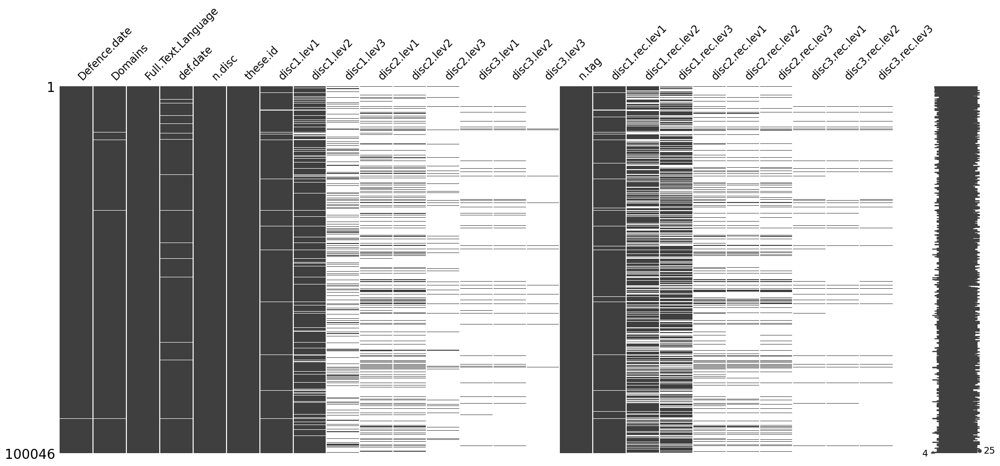

In [13]:
import missingno as msno
#Showing data sparsity across all df columns.
msno.matrix(df2)

In [14]:
def cleaning(listt):
    cleaner = [x for x in listt if str(x) != 'nan']
    return cleaner

df2['Disciplines'] = df2[['disc1.rec.lev1','disc2.rec.lev1','disc3.rec.lev1']].values.tolist()  
df2['Disciplines'] = df2['Disciplines'].apply(cleaning).values.tolist()  
df2['Disciplines'].head()

0       [X]
1      [IV]
2       [X]
3    [V, V]
4    [V, V]
Name: Disciplines, dtype: object

In [15]:
# Convert DataFrame column into list of strings
disciplines = list(df2['Disciplines'])

In [16]:
# Import permutations from the itertools module
from itertools import permutations

In [17]:
# Define the set of discipline
flattened = [i for t in disciplines for i in t]
disc = list(set(flattened))
disc

['V',
 'VI',
 'X',
 'VIII',
 'IX',
 'VII',
 'I - Droit',
 'XII',
 'II',
 'I',
 'pharmacie',
 'III',
 'IV']

In [18]:
# Generate all possible rules from groceries list
rules = list(permutations(disc, 2))
print(rules)
print(len(rules))

[('V', 'VI'), ('V', 'X'), ('V', 'VIII'), ('V', 'IX'), ('V', 'VII'), ('V', 'I - Droit'), ('V', 'XII'), ('V', 'II'), ('V', 'I'), ('V', 'pharmacie'), ('V', 'III'), ('V', 'IV'), ('VI', 'V'), ('VI', 'X'), ('VI', 'VIII'), ('VI', 'IX'), ('VI', 'VII'), ('VI', 'I - Droit'), ('VI', 'XII'), ('VI', 'II'), ('VI', 'I'), ('VI', 'pharmacie'), ('VI', 'III'), ('VI', 'IV'), ('X', 'V'), ('X', 'VI'), ('X', 'VIII'), ('X', 'IX'), ('X', 'VII'), ('X', 'I - Droit'), ('X', 'XII'), ('X', 'II'), ('X', 'I'), ('X', 'pharmacie'), ('X', 'III'), ('X', 'IV'), ('VIII', 'V'), ('VIII', 'VI'), ('VIII', 'X'), ('VIII', 'IX'), ('VIII', 'VII'), ('VIII', 'I - Droit'), ('VIII', 'XII'), ('VIII', 'II'), ('VIII', 'I'), ('VIII', 'pharmacie'), ('VIII', 'III'), ('VIII', 'IV'), ('IX', 'V'), ('IX', 'VI'), ('IX', 'X'), ('IX', 'VIII'), ('IX', 'VII'), ('IX', 'I - Droit'), ('IX', 'XII'), ('IX', 'II'), ('IX', 'I'), ('IX', 'pharmacie'), ('IX', 'III'), ('IX', 'IV'), ('VII', 'V'), ('VII', 'VI'), ('VII', 'X'), ('VII', 'VIII'), ('VII', 'IX'), ('VI

In [19]:
# Import the transaction encoder function from mlxtend
from mlxtend.preprocessing import TransactionEncoder

In [20]:
# Instantiate transaction encoder and identify unique items in transactions
encoder = TransactionEncoder().fit(disciplines)

# One-hot encode transactions
onehot = encoder.transform(disciplines)

In [21]:
# Convert one-hot encoded data to DataFrame
onehot = pd.DataFrame(onehot, columns = encoder.columns_)
onehot.head()

,I,I - Droit,II,III,IV,IX,V,VI,VII,VIII,X,XII,pharmacie
0,False,False,False,False,False,False,False,False,False,False,True,False,False
1,False,False,False,False,True,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,True,False,False
3,False,False,False,False,False,False,True,False,False,False,False,False,False
4,False,False,False,False,False,False,True,False,False,False,False,False,False


In [22]:
# Compute the support
support = onehot.mean()

# Print the support
print(support)

I            0.005717
I - Droit    0.012284
II           0.037063
III          0.026458
IV           0.087250
IX           0.272125
V            0.196250
VI           0.088189
VII          0.046808
VIII         0.086630
X            0.159727
XII          0.022400
pharmacie    0.005617
dtype: float64


In [23]:
# Compute support for I and I - Droit
supportPT = np.logical_and(onehot['I'], onehot['I - Droit']).mean()

# Compute support for I
supportP = onehot['I'].mean()

# Compute support for Twilight
supportT = onehot['I - Droit'].mean()

# Compute confidence for both rules
confidencePT = supportPT / supportP
confidenceTP = supportPT / supportT

# Print results
print('{0:.2f}, {1:.2f}'.format(confidencePT, confidenceTP))

0.04, 0.02


In [24]:
def conviction(antecedent, consequent):
	# Compute support for antecedent AND consequent
    supportAC = np.logical_and(antecedent, consequent).mean()

	# Compute support for antecedent
    supportA = antecedent.mean()

	# Compute support for NOT consequent
    supportnC = 1.0 - consequent.mean()

	# Compute support for antecedent and NOT consequent
    supportAnC = supportA - supportAC

    # Return conviction
    return supportA * supportnC / supportAnC

In [25]:
# Define a function to compute Zhang's metric
def zhang(antecedent, consequent):
	# Compute the support of each book
    supportA = antecedent.mean()
    supportC = consequent.mean()

	# Compute the support of both books
    supportAC = np.logical_and(antecedent, consequent).mean()

	# Complete the expressions for the numerator and denominator
    numerator = supportAC - supportA*supportC
    denominator = max(supportAC*(1-supportA), supportA*(supportC-supportAC))

	# Return Zhang's metric
    return numerator / denominator

In [26]:
from mlxtend.frequent_patterns import apriori
# Compute frequent itemsets using a minimum support of 0.07
frequent_itemsets = apriori(onehot, min_support = 0.006, max_len = 3, use_colnames = True)
frequent_itemsets

,support,itemsets
0,0.012284,(I - Droit)
1,0.037063,(II)
2,0.026458,(III)
3,0.087250,(IV)
4,0.272125,(IX)
5,0.196250,(V)
6,0.088189,(VI)
7,0.046808,(VII)
8,0.086630,(VIII)
9,0.159727,(X)


In [27]:
from mlxtend.frequent_patterns import association_rules
# Compute the association rules
rules = association_rules(frequent_itemsets, 
                          metric = 'support', 
                          min_threshold = 0.0)

In [28]:
rules

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
0,(V),(IX),0.196250,0.272125,0.011105,0.056586,0.207940,-0.042300,0.771533
1,(IX),(V),0.272125,0.196250,0.011105,0.040808,0.207940,-0.042300,0.837945
2,(IX),(VI),0.272125,0.088189,0.013074,0.048044,0.544783,-0.010925,0.957829
3,(VI),(IX),0.088189,0.272125,0.013074,0.148249,0.544783,-0.010925,0.854563
4,(IX),(VIII),0.272125,0.086630,0.006567,0.024132,0.278566,-0.017007,0.935957
5,(VIII),(IX),0.086630,0.272125,0.006567,0.075805,0.278566,-0.017007,0.787577


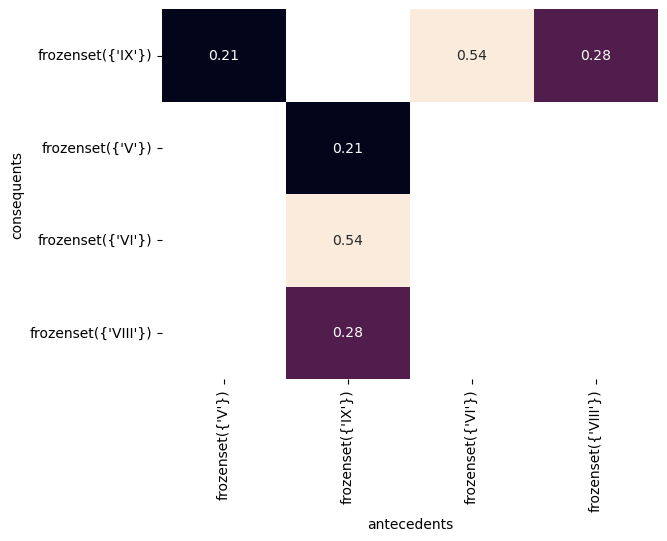

In [29]:
# Import seaborn under its standard alias
import seaborn as sns
import matplotlib.pyplot as plt

# Transform the DataFrame of rules into a matrix using the lift metric
pivot = rules.pivot(index = 'consequents', 
                    columns = 'antecedents', values= 'lift')

# Generate a heatmap with annotations on and the colorbar off
sns.heatmap(pivot, annot = True, cbar = False)
plt.yticks(rotation=0)
plt.xticks(rotation=90)
plt.show()

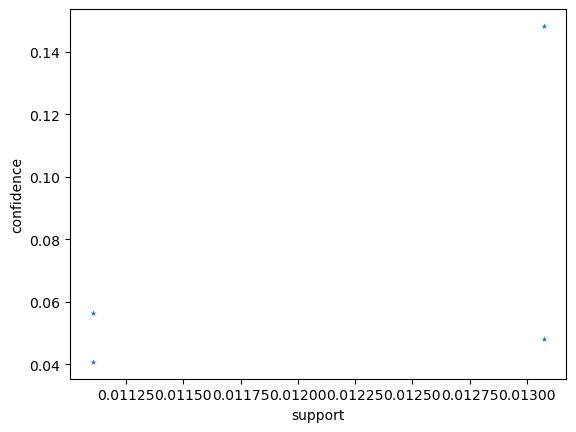

In [30]:
# Import seaborn under its standard alias
import seaborn as sns

# Apply the Apriori algorithm with a support value of 0.0075
frequent_itemsets = apriori(onehot, min_support = 0.0075, 
                            use_colnames = True, max_len = 2)

# Generate association rules without performing additional pruning
rules = association_rules(frequent_itemsets, metric='support', 
                          min_threshold = 0.0)

# Generate scatterplot using support and confidence
sns.scatterplot(x = "support", y = "confidence", data = rules, marker ="*")
plt.show()

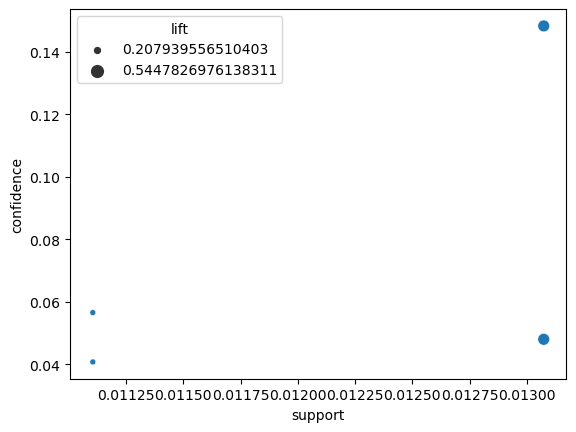

In [31]:
# Import seaborn under its standard alias
import seaborn as sns

# Apply the Apriori algorithm with a support value of 0.0075
frequent_itemsets = apriori(onehot, min_support = 0.0075, 
                            use_colnames = True, max_len = 2)

# Generate association rules without performing additional pruning
rules = association_rules(frequent_itemsets, metric = "support", 
                          min_threshold = 0.0)

# Generate scatterplot using support and confidence
sns.scatterplot(x = "support", y = "confidence", 
                size = "lift", data = rules)
plt.show()

In [32]:
def rules_to_coordinates(rules):
    rules['antecedent'] = rules['antecedents'].apply(lambda antecedent: list(antecedent)[0])
    rules['consequent'] = rules['consequents'].apply(lambda consequent: list(consequent)[0])
    rules['rule'] = rules.index
    return rules[['antecedent','consequent','rule']]

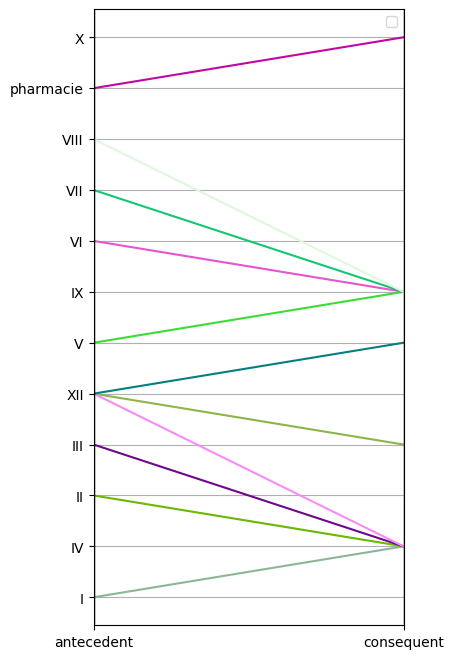

In [33]:
from pandas.plotting import parallel_coordinates

# Compute the frequent itemsets
frequent_itemsets = apriori(onehot, min_support = 0.001, 
                            use_colnames = True, max_len = 2)

# Compute rules from the frequent itemsets
rules = association_rules(frequent_itemsets, metric = 'confidence', 
                          min_threshold = 0.05)

# Convert rules into coordinates suitable for use in a parallel coordinates plot
coords = rules_to_coordinates(rules)

# Generate parallel coordinates plot
plt.figure(figsize=(4,8))
parallel_coordinates(coords, 'rule')
plt.legend([])
plt.grid(True)
plt.show()

# Exploring sequential data

In [34]:
import warnings 
warnings.filterwarnings('ignore')

In [35]:
df3 = pd.read_csv('Data sets/messages.db.csv')
df3.head()

,conversationid,user1,user2,rank,inverse.rank,timestamp,mess.sentim,message.id,message.type,sender.id,reader.id,N.words
0,1,1,2759.0,1,14,17320,3,1,aff.nor,1.0,2759.0,41
1,1,1,2759.0,2,13,17320,1,2,chunk,2759.0,1.0,43
2,1,1,2759.0,3,12,17320,-3,3,aff.nor,2759.0,1.0,26
3,1,1,2759.0,4,11,17320,-2,4,questn,2759.0,1.0,2
4,1,1,2759.0,5,10,17320,-1,5,aff.nor,1.0,2759.0,23


In [36]:
df3.describe

<bound method NDFrame.describe of         conversationid  user1   user2  rank  inverse.rank  timestamp  \
0                    1      1  2759.0     1            14      17320   
1                    1      1  2759.0     2            13      17320   
2                    1      1  2759.0     3            12      17320   
3                    1      1  2759.0     4            11      17320   
4                    1      1  2759.0     5            10      17320   
...                ...    ...     ...   ...           ...        ...   
388403           25048   1500  2314.0     6             5      17199   
388404           25048   1500  2314.0     7             4      17200   
388405           25048   1500  2314.0     8             3      17201   
388406           25048   1500  2314.0     9             2      17201   
388407           25048   1500  2314.0    10             1      17202   

        mess.sentim  message.id message.type  sender.id  reader.id  N.words  
0                 3    

In [37]:
convers1 = df3.loc[(df3['conversationid'] == 1)]
convers1

,conversationid,user1,user2,rank,inverse.rank,timestamp,mess.sentim,message.id,message.type,sender.id,reader.id,N.words
0,1,1,2759.0,1,14,17320,3,1,aff.nor,1.0,2759.0,41
1,1,1,2759.0,2,13,17320,1,2,chunk,2759.0,1.0,43
2,1,1,2759.0,3,12,17320,-3,3,aff.nor,2759.0,1.0,26
3,1,1,2759.0,4,11,17320,-2,4,questn,2759.0,1.0,2
4,1,1,2759.0,5,10,17320,-1,5,aff.nor,1.0,2759.0,23
5,1,1,2759.0,6,9,17320,-3,6,questn,2759.0,1.0,18
6,1,1,2759.0,7,8,17320,-1,7,aff.nor,2759.0,1.0,37
7,1,1,2759.0,8,7,17320,4,8,aff.nor,1.0,2759.0,44
8,1,1,2759.0,9,6,17320,-3,9,aff.nor,1.0,2759.0,25
9,1,1,2759.0,10,5,17320,7,10,chunk,2759.0,1.0,48


In [38]:
grouped = df3.groupby('conversationid')['message.type'].apply(', '.join).reset_index()
grouped.head()

,conversationid,message.type
0,1,"aff.nor, chunk, aff.nor, questn, aff.nor, ques..."
1,2,"aff.nor, aff.nor, aff.nor, aff.nor, aff.nor, a..."
2,3,"questn, aff.nor, questn, aff.nor, aff.nor, aff..."
3,4,"aff.nor, aff.nor, aff.nor, questn, questn, aff..."
4,5,"aff.nor, aff.nor, aff.off, aff.off, aff.off, end"


In [39]:
grouped['message.type_last_six'] = grouped['message.type'].apply(lambda x: x.split(', ')[-6:])

In [40]:
grouped.head()

,conversationid,message.type,message.type_last_six
0,1,"aff.nor, chunk, aff.nor, questn, aff.nor, ques...","[aff.nor, chunk, questn, aff.nor, aff.nor, end]"
1,2,"aff.nor, aff.nor, aff.nor, aff.nor, aff.nor, a...","[chunk, questn, chunk, aff.nor, questn, end]"
2,3,"questn, aff.nor, questn, aff.nor, aff.nor, aff...","[aff.nor, aff.nor, chunk, aff.nor, questn, phone]"
3,4,"aff.nor, aff.nor, aff.nor, questn, questn, aff...","[chunk, aff.nor, chunk, chunk, questn, end]"
4,5,"aff.nor, aff.nor, aff.off, aff.off, aff.off, end","[aff.nor, aff.nor, aff.off, aff.off, aff.off, ..."


In [41]:
messages = grouped['message.type_last_six'].tolist()

In [42]:
df4 = pd.DataFrame(messages,columns = ['m1','m2','m3','m4','m5','m6'])

In [43]:
df4.dropna(inplace= True)
df4.head()

,m1,m2,m3,m4,m5,m6
0,aff.nor,chunk,questn,aff.nor,aff.nor,end
1,chunk,questn,chunk,aff.nor,questn,end
2,aff.nor,aff.nor,chunk,aff.nor,questn,phone
3,chunk,aff.nor,chunk,chunk,questn,end
4,aff.nor,aff.nor,aff.off,aff.off,aff.off,end


In [44]:
df4.to_csv('Data sets/df_grouped.csv')

In [45]:
# Convert the text data into a list of words
grouped["message.type"] = grouped["message.type"].apply(lambda x: x.split(","))

In [46]:
grouped["message.type"].shape

(25036,)

In [47]:
from nltk.util import ngrams
# Convert the text data into a list of trigrams
trigrams = []
for text in grouped["message.type"]:
    trigrams.extend(list(ngrams(text, 3)))

In [48]:
len(trigrams)

338336

In [49]:
import nltk
from nltk import FreqDist
# Use the FreqDist function to find the most frequent trigrams
fdist = FreqDist(trigrams)
most_common_trigrams = fdist.most_common(10)

print("The most common trigrams: ", most_common_trigrams)

The most common trigrams:  [((' aff.nor', ' aff.nor', ' aff.nor'), 70528), ((' aff.nor', ' aff.nor', ' questn'), 24573), ((' aff.nor', ' questn', ' aff.nor'), 23375), ((' questn', ' aff.nor', ' aff.nor'), 23337), ((' aff.nor', ' aff.nor', ' chunk'), 14125), ((' chunk', ' aff.nor', ' aff.nor'), 11697), ((' aff.nor', ' chunk', ' aff.nor'), 11679), ((' aff.nor', ' questn', ' questn'), 10183), ((' questn', ' aff.nor', ' questn'), 8219), ((' questn', ' questn', ' aff.nor'), 7855)]


### Simple motif extraction with the n-gram approach

In [50]:
# Create a dataframe with the most common trigrams and their frequencies
result = pd.DataFrame(most_common_trigrams, columns=['trigram', 'frequency'])

# Calculate the percentage of the frequency distribution
result['percentage'] = result['frequency'] / result['frequency'].sum() * 100

# Print the result
result

,trigram,frequency,percentage
0,"( aff.nor, aff.nor, aff.nor)",70528,34.308341
1,"( aff.nor, aff.nor, questn)",24573,11.953534
2,"( aff.nor, questn, aff.nor)",23375,11.370767
3,"( questn, aff.nor, aff.nor)",23337,11.352282
4,"( aff.nor, aff.nor, chunk)",14125,6.871105
5,"( chunk, aff.nor, aff.nor)",11697,5.690005
6,"( aff.nor, chunk, aff.nor)",11679,5.681249
7,"( aff.nor, questn, questn)",10183,4.953520
8,"( questn, aff.nor, questn)",8219,3.998132
9,"( questn, questn, aff.nor)",7855,3.821064


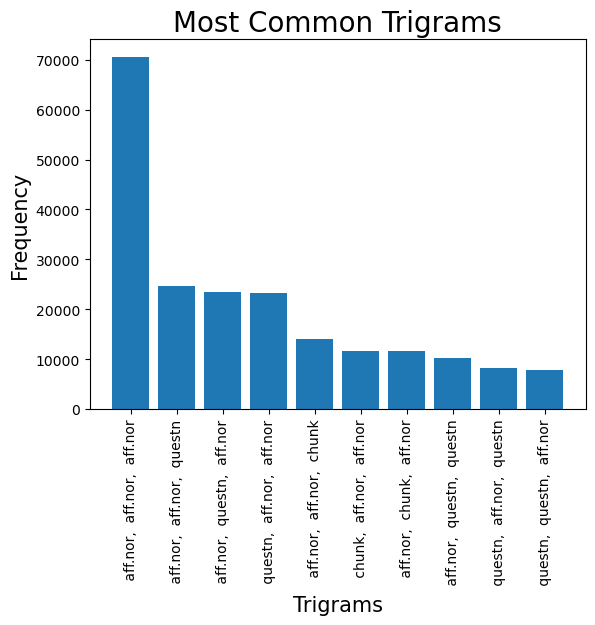

In [51]:
# Plot the result as a bar plot
plt.bar(result['trigram'].apply(', '.join), result['frequency'])
plt.xticks(rotation=90)
plt.xlabel("Trigrams", fontsize=15)
plt.ylabel("Frequency", fontsize=15)
plt.title("Most Common Trigrams", fontsize=20)
plt.show()

## Transition martrix

In [52]:
df5 = pd.read_csv('Data sets/df_grouped.csv')

In [53]:
df5 = df5.iloc[:, -2:]
df5.head()

,m5,m6
0,aff.nor,end
1,questn,end
2,questn,phone
3,questn,end
4,aff.off,end


In [54]:
df5 = pd.crosstab(df5['m5'], df5['m6']).reindex(fill_value=0)
df5

m6,end,phone,piss.off
m5,,,
aff.nor,5468,1842,382
aff.off,1696,81,1284
chunk,3768,412,67
piss.off,205,69,19
questn,7518,811,147


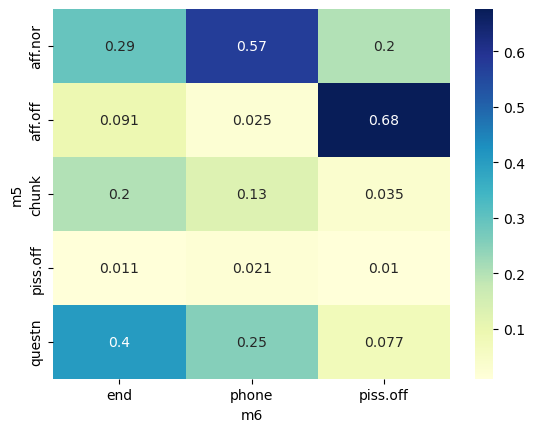

In [55]:
import seaborn as sns
import matplotlib.pyplot as plt

# Normalize the values
df_norm = df5 / df5.sum()
df_norm
# Plot the heatmap
sns.heatmap(df_norm, annot=True, cmap='YlGnBu')

# Show the plot
plt.show()

# Sequential Pattern Mining

#### 1. In around 10 to 20 lines, explain the main differences between GSP, SPADE and Prefixspan algorithms.
GSP (Generalized Sequential Pattern) algorithm is a widely used sequential pattern mining algorithm that extracts frequently occurring patterns in sequential data. It is a two-step approach where the first step generates candidate patterns and the second step prunes the patterns based on user-defined minimum support.

SPADE (Sequential PAttern Discovery using Equivalence classes) algorithm is a vertical data representation-based algorithm that compresses the input sequence database into a set of equivalence classes to avoid redundant pattern discovery. It recursively generates frequent sequential patterns by merging the equivalence classes and pruning infrequent patterns.

Prefixspan algorithm is a sequential pattern mining algorithm that uses a depth-first search approach to extract frequent sequential patterns. It works by maintaining a set of prefix trees that store the frequent patterns and extending the trees by adding new sequential elements to the prefixes. Unlike GSP and SPADE, Prefixspan can handle complex sequential patterns with variable lengths.

In summary, GSP and SPADE are horizontal data representation-based algorithms that rely on candidate generation and pruning, while Prefixspan is a vertical data representation-based algorithm that uses a depth-first search approach to extract frequent sequential patterns. Each algorithm has its own strengths and limitations and can be chosen based on the specific requirements of the problem at hand.

In [56]:
from prefixspan import PrefixSpan

db = pd.read_csv("Data sets/messages.db.transaction.csv")
db.describe()

,ABACACAAABCAAD
count,25035
unique,20964
top,ACCCD
freq,59


In [57]:
db = db.values.tolist()

In [58]:
ps = PrefixSpan(db)

In [59]:
print(ps.topk(5))

#print(ps.frequent(2, closed=True))

#print(ps.topk(5, closed=True))

#print(ps.frequent(2, generator=True))

#print(ps.topk(5, generator=True))

[(59, ['ACCCD']), (54, ['AAD']), (54, ['CCCD']), (53, ['ABBCD']), (51, ['BBCD'])]


In [60]:
new_db = []
for seq in db:
    seq_str = seq[0]
    seq_list = [char for char in seq_str]
    new_db.append(seq_list)

bb = new_db

In [61]:
from gsppy.gsp import GSP
result = GSP(bb).search(0.3)

In [62]:
result

[{('A',): 24573, ('C',): 22854, ('B',): 19555, ('D',): 19629, ('G',): 7541},
 {('A', 'A'): 22817,
  ('B', 'B'): 8574,
  ('B', 'C'): 8620,
  ('A', 'C'): 20045,
  ('C', 'A'): 19446,
  ('A', 'B'): 15793,
  ('B', 'A'): 13856,
  ('C', 'C'): 11252,
  ('C', 'D'): 7901},
 {('A', 'A', 'A'): 19111,
  ('A', 'A', 'C'): 16446,
  ('A', 'A', 'B'): 11635,
  ('A', 'B', 'A'): 9461,
  ('A', 'C', 'A'): 14707,
  ('A', 'C', 'C'): 9012,
  ('B', 'A', 'A'): 9957,
  ('C', 'A', 'A'): 15863},
 {('A', 'A', 'A', 'B'): 7946,
  ('A', 'A', 'A', 'A'): 14214,
  ('A', 'A', 'A', 'C'): 12137,
  ('A', 'A', 'C', 'A'): 10903,
  ('A', 'C', 'A', 'A'): 11031,
  ('C', 'A', 'A', 'A'): 11651},
 {('A', 'A', 'A', 'A', 'A'): 9658,
  ('A', 'A', 'A', 'A', 'C'): 8233,
  ('A', 'C', 'A', 'A', 'A'): 7563,
  ('C', 'A', 'A', 'A', 'A'): 7842}]

# Episode mining

### Explain the difference between a serial, a parallel episode, non serial non parallel episode involving three different events

A serial episode involves a sequence of events that occur in a specific order, with each event depending on the previous one. 

A parallel episode involves multiple events occurring simultaneously or independently of each other. These events are not linked in a linear fashion, and they may or may not be related to each other.

A non-serial, non-parallel episode involves three events that are neither linked in a linear fashion nor occurring simultaneously or independently of each other. In this type of episode, the events may be completely unrelated to each other.


### Explain the differences between the MINEPI and the WINEPI algorithms
MINEPI and WINEPI are algorithms used for estimating causal effects of an exposure on an outcome variable in the presence of bias. MINEPI adjusts for prevalent outcome bias while WINEPI adjusts for prevalent exposure bias. They are based on counterfactual reasoning and use different weighting procedures to balance covariate distributions and estimate exposure prevalence in the study.

In [63]:
from episode_mining.minepi import MINEPI, MinEpiRules 

In [64]:
df6 = pd.read_csv('Data sets/Artificial - Loan Process.csv')
df6.head()

,case,event,completeTime
0,trace 0,register application,2013-04-16 10:08:02
1,trace 0,check credit,2013-04-16 10:16:03
2,trace 0,calculate capacity,2013-04-16 10:16:28
3,trace 0,check system,2013-04-16 10:20:25
4,trace 0,accept,2013-04-16 10:21:30


In [65]:
from datetime import datetime
df6['completeTime'] = pd.to_datetime(df6['completeTime'])

In [66]:
# Convert the datetime column to Unix time in seconds
df6['unix_time'] = (df6['completeTime'].astype(int) / 10**9).astype(int)
df6.head()

,case,event,completeTime,unix_time
0,trace 0,register application,2013-04-16 10:08:02,1366106882
1,trace 0,check credit,2013-04-16 10:16:03,1366107363
2,trace 0,calculate capacity,2013-04-16 10:16:28,1366107388
3,trace 0,check system,2013-04-16 10:20:25,1366107625
4,trace 0,accept,2013-04-16 10:21:30,1366107690


In [67]:
len(df6.unix_time.unique())

584

In [68]:
df6.event.unique()

array(['register application', 'check credit', 'calculate capacity',
       'check system', 'accept', 'send decision e-mail', 'reject'],
      dtype=object)

In [69]:
def event(row):  
    if row['event'] == 'register application':
        return 'A'
    elif row['event'] == 'check credit':
        return 'B'
    elif row['event'] == 'calculate capacity':
        return 'C'
    elif row['event'] == 'check system':
        return 'D'
    elif row['event'] == 'accept':
        return 'E'
    elif row['event'] == 'send decision e-mail':
        return 'F'
    else:
        return 'G'

df6['event'] = df6.apply(lambda row: event(row), axis=1)
df6.head()

,case,event,completeTime,unix_time
0,trace 0,A,2013-04-16 10:08:02,1366106882
1,trace 0,B,2013-04-16 10:16:03,1366107363
2,trace 0,C,2013-04-16 10:16:28,1366107388
3,trace 0,D,2013-04-16 10:20:25,1366107625
4,trace 0,E,2013-04-16 10:21:30,1366107690


In [70]:
df7 = df6.drop(['case', 'completeTime'], axis=1)
df7 = df7.reindex(columns=['unix_time','event'])
df7.head()

,unix_time,event
0,1366106882,A
1,1366107363,B
2,1366107388,C
3,1366107625,D
4,1366107690,E


In [71]:
df7 =  df7.values.tolist()

In [72]:
sequence = [tuple(inner_list) for inner_list in df7]
sequence = sorted(sequence, key = lambda x:x[0])
print(sequence)

[(1366106882, 'A'), (1366107002, 'A'), (1366107342, 'A'), (1366107363, 'B'), (1366107367, 'B'), (1366107381, 'C'), (1366107388, 'C'), (1366107596, 'A'), (1366107611, 'D'), (1366107625, 'D'), (1366107690, 'E'), (1366107761, 'B'), (1366107787, 'B'), (1366107817, 'C'), (1366107856, 'E'), (1366108013, 'F'), (1366108121, 'C'), (1366108123, 'A'), (1366108158, 'D'), (1366108198, 'F'), (1366108328, 'B'), (1366108408, 'A'), (1366108413, 'D'), (1366108507, 'A'), (1366108589, 'B'), (1366108631, 'C'), (1366108674, 'E'), (1366108706, 'A'), (1366108732, 'C'), (1366108847, 'D'), (1366108857, 'B'), (1366108931, 'B'), (1366108967, 'C'), (1366108971, 'E'), (1366108975, 'C'), (1366109038, 'D'), (1366109043, 'F'), (1366109066, 'E'), (1366109109, 'F'), (1366109133, 'E'), (1366109193, 'D'), (1366109243, 'A'), (1366109249, 'A'), (1366109293, 'F'), (1366109372, 'A'), (1366109447, 'F'), (1366109466, 'A'), (1366109469, 'G'), (1366109486, 'B'), (1366109493, 'D'), (1366109574, 'C'), (1366109590, 'B'), (1366109598

In [73]:
alg = MINEPI(sequence, episode_type = 'serial')

In [74]:
freqEpisodes = alg.MinEpi(max_width =40 , step = 5, minFrequent = 1)

In [75]:
minepiRules = MinEpiRules(freqEpisodes, max_width = 50, step = 10, minConfidence=0.75)
ruleList = minepiRules.generateRules()
minepiRules.printRules(ruleList)

MINEPIRule: ['A', 'B'] [10] ==> ['A', 'B', 'D'] [40] [2, 1.0]
MINEPIRule: ['A', 'B'] [10] ==> ['A', 'B', 'D'] [50] [2, 1.0]
MINEPIRule: ['A', 'B'] [10] ==> ['A', 'B', 'G'] [40] [1, 1.0]
MINEPIRule: ['A', 'B'] [10] ==> ['A', 'B', 'G'] [50] [1, 1.0]
MINEPIRule: ['B', 'E'] [10] ==> ['B', 'E', 'A'] [30] [1, 1.0]
MINEPIRule: ['B', 'E'] [20] ==> ['B', 'E', 'A'] [30] [1, 1.0]
MINEPIRule: ['B', 'E'] [30] ==> ['B', 'E', 'A'] [30] [1, 1.0]
MINEPIRule: ['B', 'E'] [10] ==> ['B', 'E', 'A'] [40] [1, 1.0]
MINEPIRule: ['B', 'E'] [20] ==> ['B', 'E', 'A'] [40] [1, 1.0]
MINEPIRule: ['B', 'E'] [30] ==> ['B', 'E', 'A'] [40] [1, 1.0]
MINEPIRule: ['B', 'E'] [10] ==> ['B', 'E', 'A'] [50] [1, 1.0]
MINEPIRule: ['B', 'E'] [20] ==> ['B', 'E', 'A'] [50] [1, 1.0]
MINEPIRule: ['B', 'E'] [30] ==> ['B', 'E', 'A'] [50] [1, 1.0]
MINEPIRule: ['B', 'F'] [10] ==> ['B', 'F', 'C'] [40] [1, 1.0]
MINEPIRule: ['B', 'F'] [10] ==> ['B', 'F', 'C'] [50] [1, 1.0]
MINEPIRule: ['D', 'C'] [10] ==> ['D', 'C', 'B'] [20] [1, 1.0]
MINEPIRu

In [76]:
from episode_mining.winepi import WINEPI, WinEpiRules
alg = WINEPI(sequence, episode_type='parallel')
freqItems, suppData = alg.WinEpi(width=35, step=1, minFrequent=0.01)

In [77]:
winepiRules = WinEpiRules(freqItems, suppData, width=67, minConfidence=0.07)
ruleList = winepiRules.generateRules()
winepiRules.printRules(ruleList)

WINEPIRule: ['B'] ==> ['B', 'F'] [67] [0.012465679931833245, 0.11962447001817081]
WINEPIRule: ['F'] ==> ['B', 'F'] [67] [0.012465679931833245, 0.12172573189522343]
WINEPIRule: ['C'] ==> ['C', 'F'] [67] [0.012465679931833245, 0.1184763047390522]
WINEPIRule: ['F'] ==> ['C', 'F'] [67] [0.012465679931833245, 0.12172573189522343]
WINEPIRule: ['F'] ==> ['F', 'G'] [67] [0.010887745763246756, 0.10631741140215716]
WINEPIRule: ['G'] ==> ['F', 'G'] [67] [0.010887745763246756, 0.13004146249528836]
WINEPIRule: ['A'] ==> ['A', 'G'] [67] [0.013443999116356865, 0.12380122057541412]
WINEPIRule: ['G'] ==> ['A', 'G'] [67] [0.013443999116356865, 0.16057293629852998]
WINEPIRule: ['B'] ==> ['B', 'D'] [67] [0.01180294758102692, 0.11326468806783768]
WINEPIRule: ['D'] ==> ['B', 'D'] [67] [0.01180294758102692, 0.12404643449419571]
WINEPIRule: ['A'] ==> ['A', 'C'] [67] [0.010351248145927352, 0.0953211275791921]
WINEPIRule: ['C'] ==> ['A', 'C'] [67] [0.010351248145927352, 0.09838032393521297]
WINEPIRule: ['B'] ==

# Periodic pattern mining

In [78]:
from PAMI.recurringPattern.basic import RPGrowth as alg
import pandas as pd

In [79]:
inputFile = 'recurrent pattern mining_data.csv'
seperator = ','
maximumPeriodCount = 5000
minimumSupportCountList = [100, 150, 200, 250, 300] 
minRec = 1.5
#minimumSupport can also specified between 0 to 1. E.g., minSupList = [0.005, 0.006, 0.007, 0.008, 0.009]

result = pd.DataFrame(columns=['algorithm', 'minSup','maxPer', 'patterns', 'runtime', 'memory']) 
#initialize a data frame to store the results of PFPGrowth algorithm

In [80]:
algorithm = 'RPGrowth'  #specify the algorithm name
for minSupCount in minimumSupportCountList:
    obj = alg.RPGrowth('recurrent pattern mining_data.csv', minPS=minSupCount, maxPer=maximumPeriodCount, minRec=minRec, sep=seperator)
    obj.startMine()
    #store the results in the data frame
    result.loc[result.shape[0]] = [algorithm, minSupCount,maximumPeriodCount, len(obj.getPatterns()), obj.getRuntime(), obj.getMemoryRSS()]

Recurring patterns were generated successfully using RPGrowth algorithm 
Recurring patterns were generated successfully using RPGrowth algorithm 
Recurring patterns were generated successfully using RPGrowth algorithm 
Recurring patterns were generated successfully using RPGrowth algorithm 
Recurring patterns were generated successfully using RPGrowth algorithm 


In [81]:
print(result)

  algorithm  minSup  maxPer  patterns   runtime     memory
0  RPGrowth     100    5000        38  0.379241  325533696
1  RPGrowth     150    5000        32  0.190672  323305472
2  RPGrowth     200    5000        29  0.269478  322187264
3  RPGrowth     250    5000        27  0.192198  314195968
4  RPGrowth     300    5000        26  0.189923  312926208


In [82]:
from PAMI.extras.graph import plotLineGraphsFromDataFrame as plt

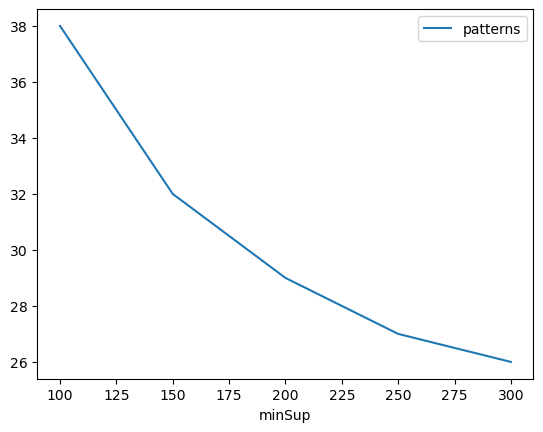

Graph for No Of Patterns is successfully generated!


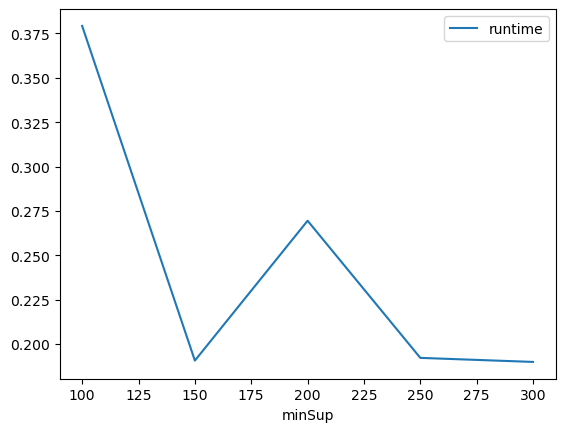

Graph for Runtime taken is successfully generated!


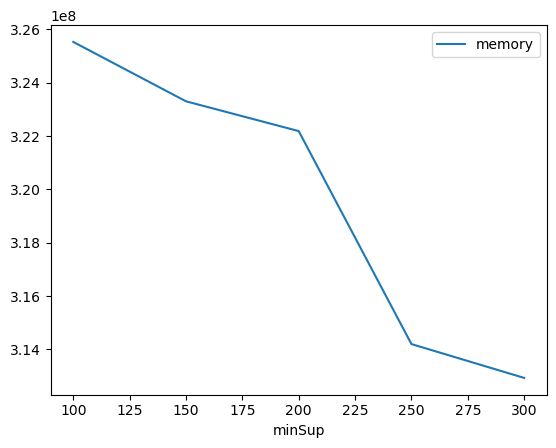

Graph for memory consumption is successfully generated!


In [83]:
ab = plt.plotGraphsFromDataFrame(result)
ab.plotGraphsFromDataFrame() #drawPlots()

In [84]:
from PAMI.extras.graph import generateLatexFileFromDataFrame as gdf
gdf.generateLatexCode(result)

Latex files generated successfully


In [85]:
df = obj.getPatternsAsDataFrame()

In [86]:
df

,Patterns,Support,Recurrance,intervals
0,1 1 0,349,1,"{{[1377, 33393] : 349}}"
1,7 9,378,1,"{{[20, 35939] : 378}}"
2,1 0 1,462,1,"{{[59, 35807] : 462}}"
3,8 0,463,1,"{{[1136, 35996] : 463}}"
4,9 4,523,1,"{{[4994, 36239] : 523}}"
5,3 3,577,1,"{{[1, 36163] : 577}}"
6,1 0 3,578,1,"{{[7, 35673] : 578}}"
7,1 0 6,593,1,"{{[93, 36248] : 593}}"
8,2,600,1,"{{[334, 36125] : 600}}"
9,5 4,601,1,"{{[1192, 31619] : 601}}"


# Spatial associations

### Data Understanding

In [87]:
#pip install pysal

In [88]:
import libpysal as lps
from pysal.lib import examples

pysal.open -> pysal.lib.io.open

In [89]:
import pysal
import pandas
import shapefile as shp
import matplotlib.pyplot as plt

pandas.set_option('display.max_rows', 100, "display.max_columns", 100)
%matplotlib inline
!python --version

zsh:1: command not found: python


In [90]:
# function that reads a shapefile and plots its shapes
def shape_layer(shapefile, style="g-"):
    sf = shp.Reader(shapefile)
    coords = []
    for shape in sf.shapeRecords():
        x = [i[0] for i in shape.shape.points[:]]
        y = [i[1] for i in shape.shape.points[:]]
        plt.plot(x, y, style, zorder=10)

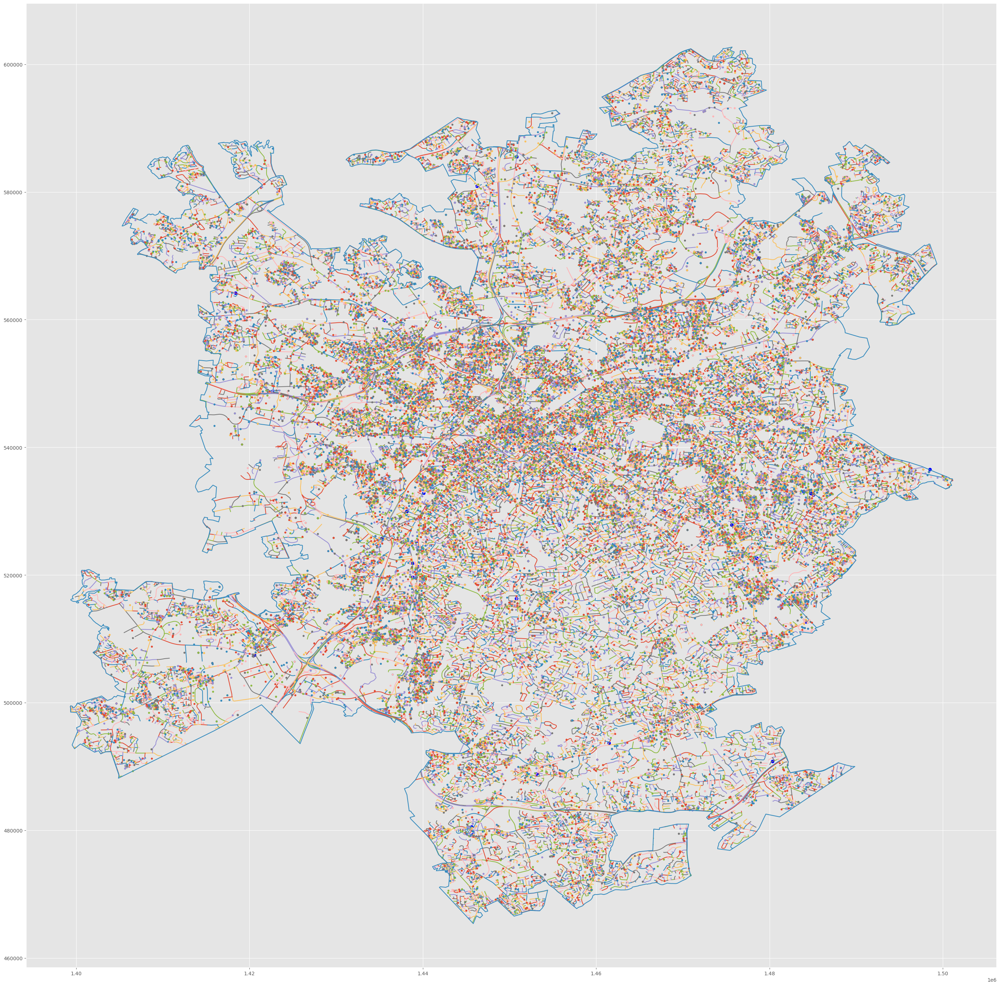

In [91]:
fig_size = [35, 35]
plt.rcParams["figure.figsize"] = fig_size
plt.style.use('ggplot')
plt.figure()

shape_layer("Data/POI_AlcoholicDrinkingPlaces_CLIP.shp", style="bo")
shape_layer("Data/CLT_Streets.shp", style="-")
shape_layer("Data/CrimeIncident_CMPD_2010.shp", style=".")
shape_layer("Data/CLT_Boundary.shp", style="-")
plt.show()

---
### Block Groups

Charlotte block groups with last 6 non-spatial attributes for 
- <b>ARPCIncome</b>: percapital Income; type: real, length 18
- <b>ARPerHEdu</b>: percentage of education with high school and above
- <b>ARPerWork</b>: percentage of population employed
- <b>ARPerRMI5L</b>: percentage of population who rent and moved in less than 5 years ago
- <b>ARPer3MU</b>: percentage of home with 3 or more multiple unit structure


In [92]:
db_bgroups = pysal.lib.io.open('Data/CLT_BlockGroups_Attr.dbf','r')
df_bgroups = pandas.DataFrame(db_bgroups[:], columns=db_bgroups.header)
df_bgroups.shape
df_bgroups[:5]

,STATEFP10,COUNTYFP10,TRACTCE10,BLKGRPCE10,GEOID10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,ARPCIncome,ARPerHEdu,ARPerWork,ARPerMI5L,ARPerRMI5L,ARPer3MU
0,37,119,005301,1,371190053011,Block Group 1,G5030,S,3692032,0,+35.2582845,-080.8060757,12375.0,7.486865,69.674647,73.998045,68.132942,82.098765
1,37,119,001400,2,371190014002,Block Group 2,G5030,S,1051009,0,+35.2437169,-080.8024062,39139.0,13.474495,83.140878,55.172414,25.689655,27.016645
2,37,119,001200,3,371190012003,Block Group 3,G5030,S,2111630,6882,+35.2274080,-080.7930404,60271.0,9.193122,89.514066,23.713927,12.421581,3.436019
3,37,119,005847,1,371190058471,Block Group 1,G5030,S,2937830,19993,+35.0855266,-080.7642117,70142.0,13.423352,84.393758,20.808081,0.000000,0.000000
4,37,119,000700,1,371190007001,Block Group 1,G5030,S,1271722,0,+35.2385940,-080.8190269,28051.0,4.301075,72.321429,51.704545,29.829545,66.190476


---
### Blocks
Charlotte blocks with last 6 attributes for 
- <b>ARPopDen</b>: population density; type: real, length 18
- <b>ARPerAA</b>: percentage of population who are American African
- <b>ARHeteInx</b>: heterogeneity index for races
- <b>ARPerM1724</b>: percentage of population who are 17-24 males
- <b>ARPerHOwn</b>: percentage of population who own home
- <b>ARPerSF</b>: percentage of families with single parent


In [93]:
db_blocks = pysal.lib.io.open('Data/CLT_Blocks_Attr.dbf','r')
df_blocks = pandas.DataFrame(db_blocks[:], columns=db_blocks.header)
df_blocks[:5]

,STATEFP10,COUNTYFP10,TRACTCE10,BLOCKCE,BLOCKID10,PARTFLG,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF
0,37,119,005401,2028,371190054012028,N,0.000116,97.590361,0.047322,3.614458,84.615385,33.333333
1,37,119,004600,2025,371190046002025,N,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,37,119,004100,2005,371190041002005,N,0.000276,21.428571,0.482143,7.142857,61.290323,3.225806
3,37,119,005521,3047,371190055213047,N,0.000216,85.106383,0.266184,4.255319,100.000000,14.285714
4,37,119,005200,3043,371190052003043,N,0.000085,50.000000,0.500000,0.000000,0.000000,0.000000


### Crime per Street

In [94]:
db_crime_per_street = pysal.lib.io.open('Data/CLT_Streets_crmCntAUNCC_Business.dbf','r')
df_crime_per_street = pandas.DataFrame(db_crime_per_street[:], columns=db_crime_per_street.header)
df_crime_per_street.sort_values(by="crmCntAUNC", ascending=False)[:3]

,WHOLESTNAM,crmCntAUNC,BusinCnt
31873,N Tryon St,428,2
14911,E Trade St,392,19
904,Wilkinson Bv,376,26


### Businesses

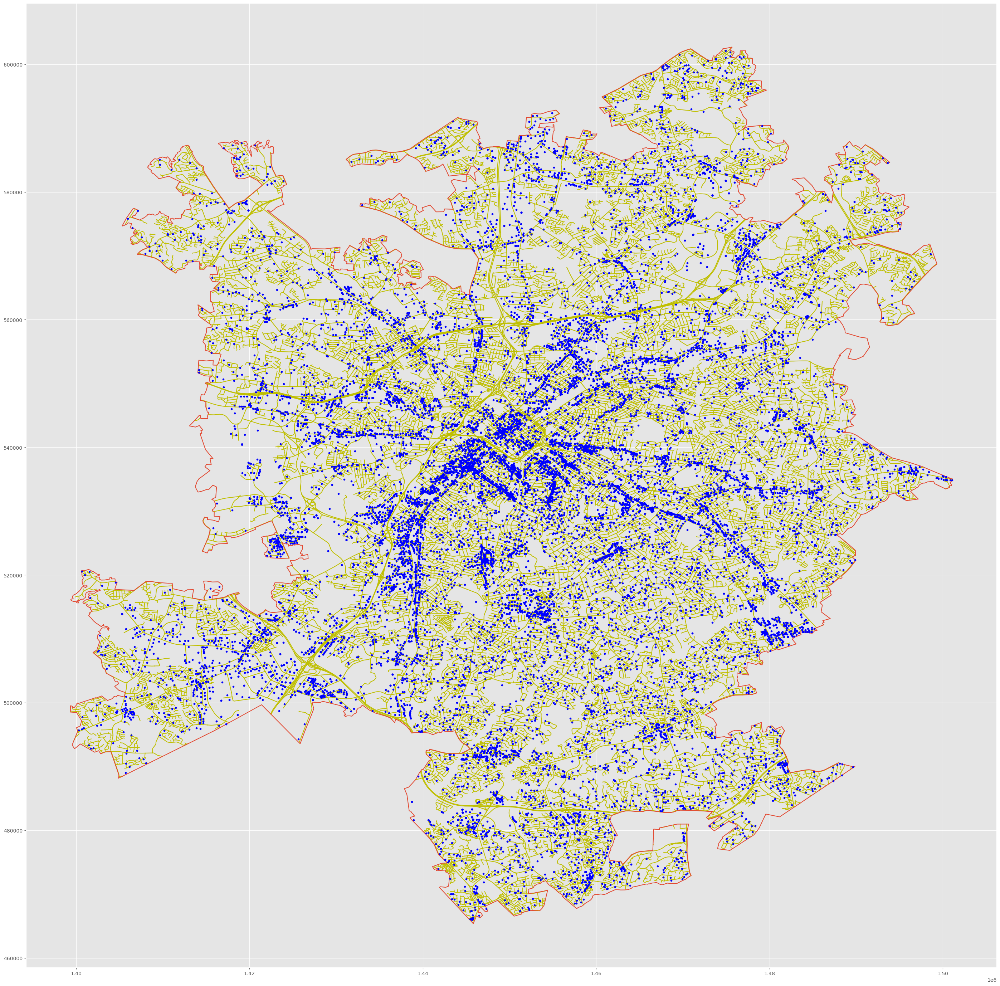

In [95]:
fig_size = [35, 35]
plt.rcParams["figure.figsize"] = fig_size
shape_layer("Data/CLT_Streets.shp", style="y-")
shape_layer("Data/CLT_Boundary.shp", style="-")
shape_layer("Data/CLT_Business_Attri.shp", style="b.")

In [96]:
db_business = pysal.lib.io.open('Data/CLT_Business_Attri.dbf','r')
df_business = pandas.DataFrame(db_business[:], columns=db_business.header)
print(df_business.shape)
df_business[:4]

(24375, 80)


,OBJECTID,Join_Count,ID,NUM_ADDR,NUMADD_M,Match_,year_,Quarter,NAICS,CntCode,legalCode,tradeNm,MarchEmp,tot_Addr,TXT_JURIS,CDE_ZIP1,Web_Addr,PhyStr1,PhyStr2,PhyStrSN,PhyStrWN,PhyCity,phyZip,PhyState,taxAddr1,taxAddr2,taxCity,taxState,taxZip,mailStr1,mailStr2,MailCity,mailSt,mailZip,geoLon,geoLat,X_Coord,Y_Coord,PID_oldgeo,PID,taxpid,gisacres,zone_id,Block_id,LandUse,PlanTypeID,PlanDesc,FlagFlood,FlagProt,cenX,cenY,city_id,county_id,uid,LandVal,newX0,newY0,newX,newY,NRBld08,newX1,newY1,notes,ID2006,SIC05,Problem,TradeName,AddUpdated,nexX2,nexY2,extra_Info,NewAdd11,emp_old,tempadd,StrMapped,WHOLESTNAM,WHOLESTN_F,ST_NAME,ST_NAME_LA,StrMapID
0,18421,1,48567.0,339743,339743,g,2008.0,1.0,531210.0,119,VIKING RESOURCES INC,V R BUSINESS BROKERS,4.0,17250 LANCASTER HY,CHARLOTTE,28277,,17250 LANCASTER HWY,SUITE 601,17250,LANCASTER HWY,CHARLOTTE,28277,NC,17250 LANCASTER HWY STE 601,,CHARLOTTE,NC,28209.0,17250 LANCASTER HWY STE 601,,CHARLOTTE,NC,28209,-080.851326,35.014948,1445679.0,465953.0,291665,22304C99,22304212,5.351901,10934,371190058182033,18,16,Office_Low,0,0,1445635,466071,1,119,291665,30000,1445679,465953,0,0,1,0,0,,0.0,0.0,0,V R BUSINESS BROKERS,0,0,0,0,0,4,0,0,LANCASTER HWY,LANCASTER HY,LANCASTER,HY,28294
1,29072,0,20100386.0,,,,2008.0,1.0,518210.0,119,,DEALER LINK INC,10.0,,,,,17232 Lancaster Hwy,,17232,Lancaster Hwy,Charlotte,28277,,,,,,0.0,,,,,,,,0.0,0.0,0,22304C99,22304212,0.000000,10934,371190058182033,18,0,,0,0,0,0,0,0,291665,30000,0,0,0,0,0,1445438,466097,,0.0,737415.0,0,DEALER LINK INC,0,0,0,1,0,10,-2,0,LANCASTER HWY,LANCASTER HY,LANCASTER,HY,28294
2,7961,1,288651.0,464886,0,g,2008.0,1.0,541410.0,119,DRAKE INTERIOR DESIGN INC,?,2.0,17206 LANCASTER HY,CHARLOTTE,28277,,17206 LANCASTER HWY STE 504,,17206,LANCASTER HWY STE 504,CHARLOTTE,28277,NC,8912 LEINSTER DRIVE,,CHARLOTTE,NC,28277.0,17206 LANCASTER HWY STE 504,,CHARLOTTE,NC,28277,-080.851223,35.015188,1445750.0,466109.0,291665,22304C99,22304212,5.351901,10934,371190058182033,18,16,Office_Low,0,0,1445635,466071,1,119,291665,30000,1445750,466109,0,0,1,0,0,,0.0,0.0,0,DRAKE INTERIOR DESIGN INC,0,0,0,0,0,2,0,0,LANCASTER HWY,LANCASTER HY,LANCASTER,HY,28294
3,12303,1,358823.0,464886,0,g,2008.0,1.0,541310.0,119,LIVING STONES ARCHITECTURE,?,4.0,17206 LANCASTER HY,CHARLOTTE,28277,,17206 LANCASTER HWY STE 501,,17206,LANCASTER HWY STE 501,CHARLOTTE,28277,NC,17206 LANCASTER HWY STE 501,,CHARLOTTE,NC,28277.0,,,,,,-080.851223,35.015188,1445750.0,466109.0,291665,22304C99,22304212,5.351901,10934,371190058182033,18,16,Office_Low,0,0,1445635,466071,1,119,291665,30000,1445750,466109,0,0,1,0,0,,0.0,0.0,0,LIVING STONES ARCHITECTURE,0,0,0,0,0,4,0,0,LANCASTER HWY,LANCASTER HY,LANCASTER,HY,28294


### Crimes

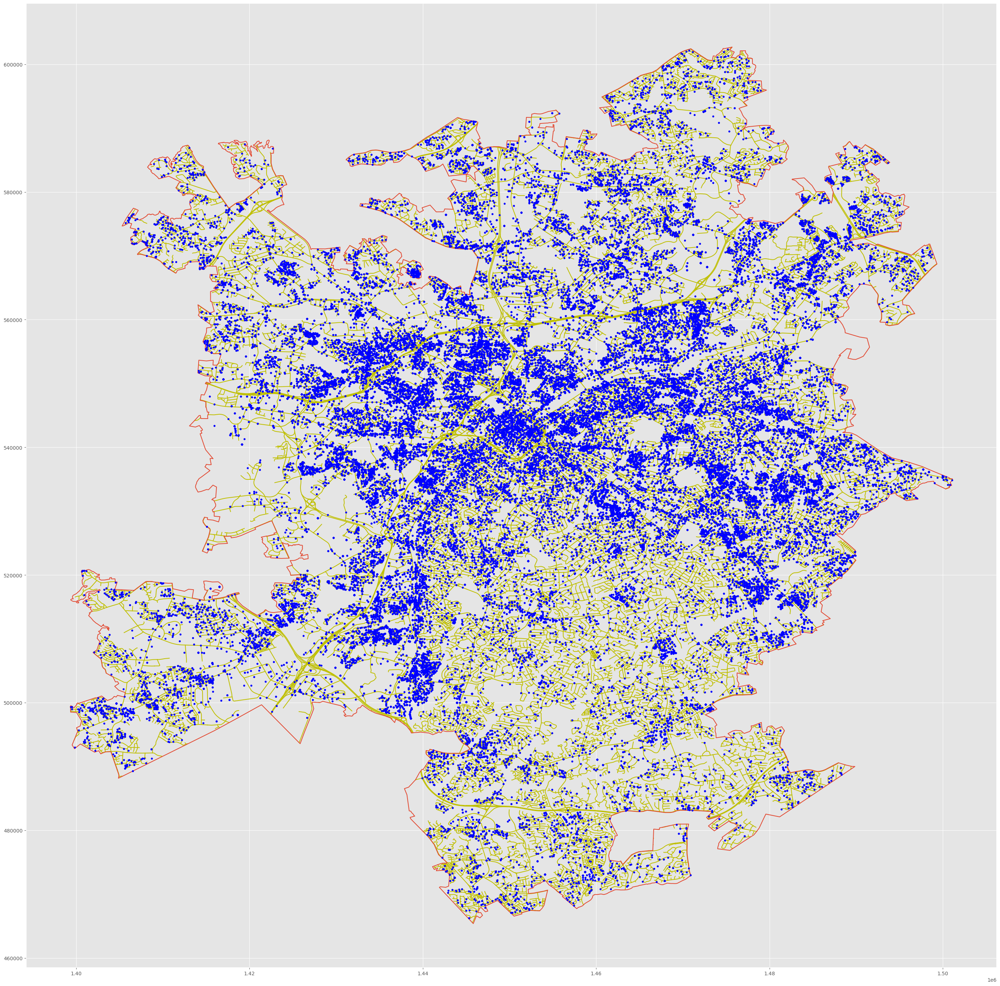

In [97]:
fig_size = [35, 35]
plt.rcParams["figure.figsize"] = fig_size
shape_layer("Data/CLT_Streets.shp", style="y-")
shape_layer("Data/CLT_Boundary.shp", style="-")
shape_layer("Data/CrimeIncident_CMPD_2010.shp", style="b.")

In [98]:
db_crimes = pysal.lib.io.open('Data/CrimeIncident_CMPD_2010.dbf','r')
df_crimes = pandas.DataFrame(db_crimes[0:-1], columns=db_crimes.header)
pandas.set_option('display.max_columns',  100)
print(df_crimes.shape)
df_crimes[:2]

(67594, 53)


,OBJECTID_1,OBJECTID,Complaint_,ComplainNo,Block_No,Direction,Street_Nam,Street_Typ,Suffix,Apt_No,City,State,ZipCode,X,Y,Division,Report_Dat,Location_D,Location_T,Incident_F,Incident_T,Place1,Place2,CSS_Called,Clearance_,Clearance1,Case_Statu,Reporting_,Follow_Up_,NIBRS_Hi_C,rp_last_na,rp_first_n,rp_middle_,rp_Block_N,rp_Directi,rp_Street_,rp_Street1,re_Suffix,rp_Apt_No,rp_City,rp_State,rp_ZipCode,F41,F42,OID_,Complaint1,Complain_1,Attempt,NIBRScateg,NIBRSclass,NOCcode,strMapped,WHOLESTNAM
0,1,1,2.010010e+13,20100101000504,1120.0,,SCALEYBARK,RD,,,CHARLOTTE,NC,,1444054.0,523228.0,26.0,01/01/2010 0005,Location of occurrence,Indoors,01/01/2010 0005,,Residential,Apartment/Duplex Private Res,N,Normal Clearance - Cleared by Arrest,1/1/2010,Close/Cleared,Charlotte-Mecklenburg Police Department,26-WESTOVER DIVISION,Simple Assault,ISENHOUR,#3907,,,,,,,,,,,,,0,2.010010e+13,20100101000504,Completed,Assault / Assault: on Government Officer or Em...,Simple Assault,13B,1,SCALEYBARK RD
1,2,2,2.010010e+13,20100101000506,8305.0,,SHINKANSEN,DR,,,CHARLOTTE,NC,28213,1481937.0,562104.0,14.0,01/01/2010 0005,Location of occurrence,Outdoors,01/01/2010 0005,,Residential,Private Residence,N,Normal Clearance - Cleared by Arrest,1/1/2010,Close/Cleared,Charlotte-Mecklenburg Police Department,14-UNIVERSITY CITY DIVISION,Drug/Narcotic Violations,ROCEDAR,ALFORD,,8309,,SHINKANSEN,DR,,,CHARLOTTE,NC,28213,,,1,2.010010e+13,20100101000506,Completed,Miscellaneous criminal / Other Unlisted Crimin...,Drug/Narcotic Violations,90Z,1,SHINKANSEN DR


### POI

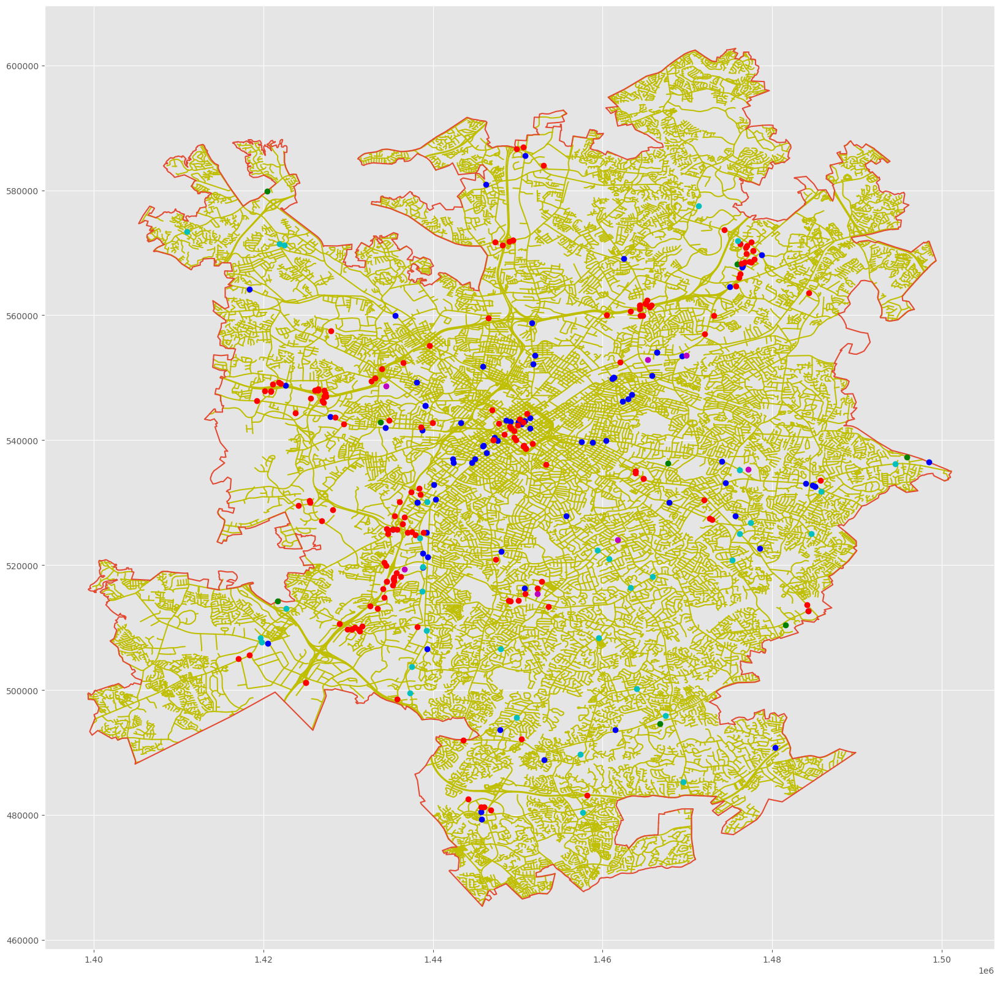

In [99]:
fig_size = [20, 20]
plt.rcParams["figure.figsize"] = fig_size
shape_layer("Data/CLT_Streets.shp", style="y-")
shape_layer("Data/CLT_Boundary.shp", style="-")

shape_layer("Data/POI_WALMART.shp", style="go")
shape_layer("Data/POI_AlcoholicDrinkingPlaces_CLIP.shp", style="bo")
shape_layer("Data/POI_HotelsMotels.shp", style="ro")
shape_layer("Data/POI_Malls.shp", style="mo")
shape_layer("Data/POI_ParknRideFacilities.shp", style="co")

In [100]:
db_mall = pysal.lib.io.open('Data/POI_Malls.dbf','r')
df_mall = pandas.DataFrame(db_mall[0:-1], columns=db_mall.header)
pandas.set_option('display.max_rows', 100)
print(len(df_mall))
df_mall

6


,OBJECTID,ADDRESS,BLDG_SF,FIRM_NAME,NAME
0,8,4400 FAIRVIEW ROAD,1161538,TRAMMELL CROW COMPANY,SOUTHPARK MALL
1,3,500 TYVOLA ROAD,298748,N/A,TYVOLA PLACE
2,2,160 S SHARON AMITY ROAD,273150,HILL PARTNERS,COTSWOLD MALL
3,7,5651 CENTRAL AVENUE,1220356,GLIMCHER PROPERTIES,EASTLAND MALL
4,5,3205 FREEDOM DRIVE,374988,FREEDOM MALL PARTNERS,FREEDOM MALL
5,4,4500 N TRYON STREET,310000,WALKER REAL ESTATE GROUP,TRYON PLACE


### Data Preparation

In [101]:
import pysal
import numpy
import scipy
import pandas
import random
import shapefile as shp
from sklearn import tree
import matplotlib.pyplot as plt
from sklearn import preprocessing

%matplotlib inline
plt.style.use('ggplot')
pandas.set_option('display.max_rows', 100, "display.max_columns", 100)

In [102]:
db_blocks_groups = pysal.lib.io.open('Data/CLT_BlockGroups_Attr.dbf','r')
df_blocks_groups = pandas.DataFrame(db_blocks_groups[:], columns=db_blocks_groups.header)

db_blocks = pysal.lib.io.open('Data/CLT_Blocks_Attr.dbf','r')
df_blocks = pandas.DataFrame(db_blocks[:], columns=db_blocks.header)

db_business = pysal.lib.io.open('Data/CLT_Business_Attri.dbf','r')
df_business = pandas.DataFrame(db_business[:], columns=db_business.header)

db_crimes = pysal.lib.io.open('Data/CrimeIncident_CMPD_2010.dbf','r')
df_crimes = pandas.DataFrame(db_crimes[:], columns=db_crimes.header)

---
### Adding census stats 
Attaching related census stats for every block (when available)

In [103]:
# add column in crime dataframe for BLOCKID10 - taken from busine dataframe
# add "not found" where BLOCKID10 could not be found
street2block = df_business.set_index('ST_NAME')["Block_id"].to_dict()
df_crimes["BLOCKID10"] = df_crimes["Street_Nam"].map(lambda street: street2block.get(street, "not found"))
df_crimes.shape

(67595, 54)

In [104]:
# remove rows where BLOCKID10 is "not found"
df_crimes = df_crimes[df_crimes["BLOCKID10"] != "not found"]
df_crimes.shape

(50455, 54)

In [105]:
# adding df_blocks' and df_blocks_groups' columns of interest
census = {}
for index, row in df_blocks_groups.iterrows():
    census[str(row["GEOID10"])] = {
        "ARPCIncome": row["ARPCIncome"],
        "ARPerHEdu":  row["ARPerHEdu"],
        "ARPerWork":  row["ARPerWork"],
        "ARPerRMI5L": row["ARPerRMI5L"],
        "ARPer3MU":   row["ARPer3MU"]}

for index, row in df_blocks.iterrows():
    census[str(row["BLOCKID10"])] = {
        "ARPopDen":   row["ARPopDen"],
        "ARPerAA":    row["ARPerAA"],
        "ARHeteInx":  row["ARHeteInx"],
        "ARPerM1724": row["ARPerM1724"],
        "ARPerHOwn":  row["ARPerHOwn"],
        "ARPerSF":    row["ARPerSF"]}

    
get_group_census = lambda col: lambda block_id: census.get(block_id[0:12], {}).get(col, "NF")
get_block_census = lambda col: lambda block_id: census.get(block_id, {}).get(col, "NF")

df_crimes["ARPCIncome"] = df_crimes["BLOCKID10"].map(get_group_census("ARPCIncome"))
df_crimes["ARPerHEdu"]  = df_crimes["BLOCKID10"].map(get_group_census("ARPerHEdu"))
df_crimes["ARPerWork"]  = df_crimes["BLOCKID10"].map(get_group_census("ARPerWork"))
df_crimes["ARPerRMI5L"] = df_crimes["BLOCKID10"].map(get_group_census("ARPerRMI5L"))
df_crimes["ARPer3MU"]   = df_crimes["BLOCKID10"].map(get_group_census("ARPer3MU"))

df_crimes["ARPopDen"]   = df_crimes["BLOCKID10"].map(get_block_census("ARPopDen"))
df_crimes["ARPerAA"]    = df_crimes["BLOCKID10"].map(get_block_census("ARPerAA"))
df_crimes["ARHeteInx"]  = df_crimes["BLOCKID10"].map(get_block_census("ARHeteInx"))
df_crimes["ARPerM1724"] = df_crimes["BLOCKID10"].map(get_block_census("ARPerM1724"))
df_crimes["ARPerHOwn"]  = df_crimes["BLOCKID10"].map(get_block_census("ARPerHOwn"))
df_crimes["ARPerSF"]    = df_crimes["BLOCKID10"].map(get_block_census("ARPerSF"))

df_crimes.shape

(50455, 65)

In [106]:
# removing all rows that don't have census attributes
# because some BLOCKID10 don't exists in df_blocks and df_block_groups
df_temp = df_crimes[df_crimes["ARPopDen"] != "NF"]
df_crimes_and_census = df_temp[df_temp["ARPCIncome"] != "NF"]
df_crimes_and_census.shape

(19106, 65)

---
### Adding nearest K POI

In [107]:
# find nearest K business/POI for a crime
crime_points    = numpy.array(pysal.lib.io.open('Data/CrimeIncident_CMPD_2010.shp', 'r'))
business_points = numpy.array(pysal.lib.io.open('Data/CLT_Business_Attri.shp', 'r'))
mall_points     = numpy.array(pysal.lib.io.open('Data/POI_Malls.shp', 'r'))
walmart_points  = numpy.array(pysal.lib.io.open("Data/POI_WALMART.shp", 'r'))
drinking_points = numpy.array(pysal.lib.io.open("Data/POI_AlcoholicDrinkingPlaces_CLIP.shp", 'r'))
hotels_points   = numpy.array(pysal.lib.io.open("Data/POI_HotelsMotels.shp", 'r'))
park_points     = numpy.array(pysal.lib.io.open("Data/POI_ParknRideFacilities.shp", 'r'))

business_name = [row["TradeName"] for i, row in df_business.iterrows()]
mall_name     = ["mall" for i in mall_points]
walmart_name  = ["walmart" for i in walmart_points]
drinking_name = ["drinking" for i in drinking_points]
hotels_name   = ["hotels" for i in hotels_points]
park_name     = ["park" for i in park_points]

names  = business_name + mall_name + walmart_name + drinking_name + hotels_name + park_name
points = numpy.concatenate((business_points, mall_points, walmart_points,
                            drinking_points, hotels_points, park_points))

In [108]:
# closest_POI -> for each crime its neighbourhood
closest_POI = []
k_closest = 5
kd_tree = scipy.spatial.cKDTree(points, leafsize=100)
for point in crime_points:
    neighborhood = kd_tree.query(point, k=k_closest)
    closest_POI.append( [str(names[neighbor]) for neighbor in neighborhood[1]] )

In [109]:
# adding closestPOI to df 
for i, row in df_crimes_and_census.iterrows():
    df_crimes_and_census.at[i,'First_POI'] = closest_POI[i][0]
    df_crimes_and_census.at[i,'Second_POI'] = closest_POI[i][1]
    df_crimes_and_census.at[i,'Third_POI'] = closest_POI[i][2]
    df_crimes_and_census.at[i,'Fourth_POI'] = closest_POI[i][3]
    df_crimes_and_census.at[i,'Fifth_POI'] = closest_POI[i][4]

df_crimes_and_census.shape

(19106, 70)

---
###  Removing useless columns

In [110]:
# keeping only some crimes' columns
col2keep = [
    "BLOCKID10",    # block ID
    "First_POI",    # first closest POI
    "Second_POI",   # second closest POI
    "Third_POI",    # third closest POI
    "Fourth_POI",   # fourth closest POI
    "Fifth_POI",    # fifth closest POI
    "ARPCIncome",   # percapital Income; type: real, length 18
    "ARPerHEdu",    # percentage of education with high school and above
    "ARPerWork",    # percentage of population employed
    "ARPerRMI5L",   # percentage of population who rent and moved in less than 5 years ago
    "ARPer3MU",     # percentage of home with 3 or more multiple unit structure
    "ARPopDen",     # population density; type: real, length 18
    "ARPerAA",      # percentage of population who are American African
    "ARHeteInx",    # heterogeneity index for races
    "ARPerM1724",   # percentage of population who are 17-24 males
    "ARPerHOwn",    # percentage of population who own home
    "ARPerSF",      # percentage of families with single parent
    "NIBRSclass",   # type of crime i guess
    "Attempt",      # completed, ecc
    "Case_Statu",   # further investigation, close/cleared, ecc
    "Clearance_",   # open, normal clearance/cleared by arrest, ecc
    "Place1",       # residential, open area, commercial place, retail
    "Place2",       # private residence, street/highway, ecc
    "Location_T",   # indoors or outdoors
    "Report_Dat",   # date
    "Street_Nam"    # street
]

df_crimes_and_census = df_crimes_and_census[col2keep]
df_crimes_and_census.shape

(19106, 26)

In [111]:
df_crimes_and_census[:3]

,BLOCKID10,First_POI,Second_POI,Third_POI,Fourth_POI,Fifth_POI,ARPCIncome,ARPerHEdu,ARPerWork,ARPerRMI5L,ARPer3MU,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF,NIBRSclass,Attempt,Case_Statu,Clearance_,Place1,Place2,Location_T,Report_Dat,Street_Nam
0,371190032011003,CAROLINA FIRST AID & SAFETY,CHARLOTTE WOOD APARTMENTS,WILDWOOD APARTMENTS,MT ZION HOLINESS CHURCH,KHL DESIGNS,23826.0,22.513562,93.014706,30.612245,20.350109,0.000151,7.425743,0.549505,8.910891,14.0,38.0,Simple Assault,Completed,Close/Cleared,Normal Clearance - Cleared by Arrest,Residential,Apartment/Duplex Private Res,Indoors,01/01/2010 0005,SCALEYBARK
12,371190015041006,UNITED TREATMENT FACILITY,LINKS AT CITI SIDE,STRAIGHT LINE PAVEMENT MARKING,JAMES D MCDUFFIE AGENT,MIDLAND NATIONAL INSURANCE CO,17393.0,14.689476,80.305424,28.855251,28.157683,0.00014,54.166667,0.53125,0.0,72.727273,36.363636,Simple Assault,Completed,Close/Cleared,Exceptionally Cleared - Victim Chose not to Pr...,Residential,Apartment/Duplex Private Res,Outdoors,01/01/2010 0110,CITISIDE
15,371190001001020,hotels,ILLUM'E,OMNI CHARLOTTE HOTEL,THE RITZ CARLTON HOTEL COMPANY LLC,BEEHIVE,106794.0,3.088803,100.0,74.468085,88.91455,0.0,0.0,0.0,0.0,0.0,0.0,Weapon Law Violations,Completed,Close/Cleared,Normal Clearance - Cleared by Arrest,Open Area,Street/Highway,Outdoors,01/01/2010 0118,COLLEGE


In the following we show some simple statistic about each variable:
- **Count**: Describes the number of not null values;
- **Unique**: Describes the number of unique values;
- **Top**: Describes the mode (in the case of multiple mode only one is shown)
- **Freq**: Describe the frequency of the returned top value

In [112]:
df_crimes_and_census.describe()

,BLOCKID10,First_POI,Second_POI,Third_POI,Fourth_POI,Fifth_POI,ARPCIncome,ARPerHEdu,ARPerWork,ARPerRMI5L,ARPer3MU,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF,NIBRSclass,Attempt,Case_Statu,Clearance_,Place1,Place2,Location_T,Report_Dat,Street_Nam
count,19106,19106,19106,19106,19106,19106,19106.0,19106.000000,19106.000000,19106.000000,19106.0,19106.0,19106.0,19106.0,19106.0,19106.0,19106.0,19106,19106,19106,19106,19106,19106,19106,19106,19106
unique,741,3813,3983,4088,4348,4393,181.0,180.000000,180.000000,168.000000,153.0,623.0,385.0,463.0,287.0,297.0,275.0,52,2,4,10,5,67,5,18673,1094
top,371190047001015,AUNTIE ANNES PRETZELS & NESTLE TOLL,hotels,ARTHURS OF CHARLOTTE INC,SHOWMARS-SOUTHPARK INC,POTTERY BARN KIDS STORE,18560.0,13.170732,71.957295,36.824697,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Theft From Motor Vehicle,Completed,Inactive,Open,Residential,Private Residence,Indoors,05/21/2010 1014,TRADE
freq,787,215,311,215,215,215,1058.0,1058.000000,1058.000000,1058.000000,1591.0,5727.0,7570.0,7663.0,9086.0,6868.0,7044.0,2523,18413,9803,11520,8414,3950,8451,3,787


In [113]:
df_crimes_and_census.replace(0, numpy.nan).describe()

,ARPCIncome,ARPerHEdu,ARPerWork,ARPerRMI5L,ARPer3MU,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF
count,19106.000000,18550.000000,19106.000000,18785.000000,17515.000000,1.337900e+04,11536.000000,11443.000000,10020.000000,12238.000000,12062.000000
mean,32143.145295,13.654647,75.291682,41.441861,39.024404,1.732083e-04,51.646927,0.368186,5.923497,57.136425,27.696651
std,29527.596815,13.254983,12.646551,21.316652,27.910962,1.635689e-04,34.419660,0.203971,4.047635,30.217798,16.837132
min,6203.000000,0.554017,36.974790,0.721371,1.809211,3.699000e-07,0.490196,0.015872,0.371747,0.719424,0.628931
25%,12375.000000,7.037037,67.435897,25.912409,19.542421,8.250850e-05,15.789474,0.154481,3.225806,35.714286,12.500000
50%,18560.000000,11.480602,75.030750,40.944882,29.477021,1.334896e-04,53.846154,0.402042,5.263158,54.545455,28.542510
75%,41499.000000,13.636364,83.985765,57.195572,59.402985,1.998811e-04,86.486486,0.538108,8.333333,84.375000,38.000000
max,149122.000000,72.421525,100.000000,97.619048,97.300771,1.311533e-03,100.000000,0.752447,42.177914,100.000000,100.000000


### Discretization

##### Income, Density and Heterogeneity index

<function print>

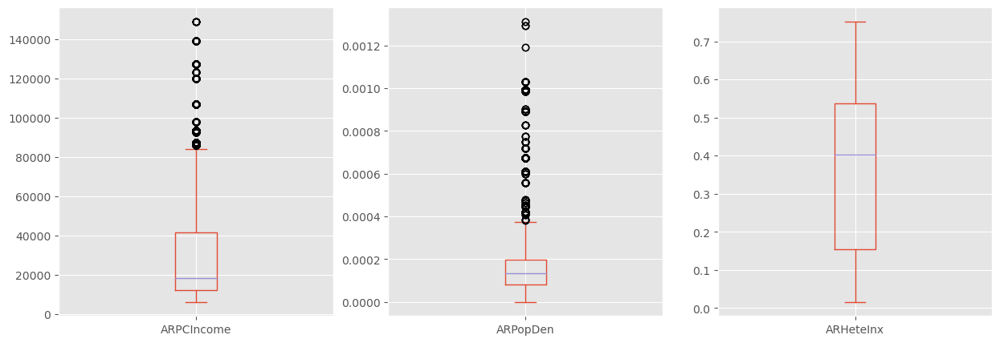

In [114]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size

df_crimes_and_census[["ARPCIncome", "ARPopDen", "ARHeteInx"]].replace(0, numpy.nan).plot.box(subplots=True)
print

##### Some percentage

<function print>

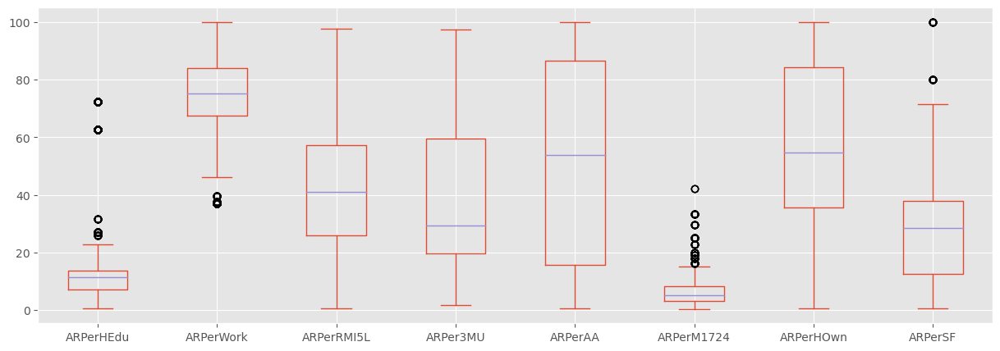

In [115]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size
df_crimes_and_census[[
        "ARPerHEdu", "ARPerWork", "ARPerRMI5L", "ARPer3MU", 
        "ARPerAA", "ARPerM1724", "ARPerHOwn", "ARPerSF"]].replace(0, numpy.nan).plot.box()
print

In [116]:
label2discretize = lambda attr, n: [ attr + "-" + str(i) + "/" + str(n) for i in range(1, n + 1)]
print("Example of discretization in 5 parts: ", label2discretize("inc", 5))

Example of discretization in 5 parts:  ['inc-1/5', 'inc-2/5', 'inc-3/5', 'inc-4/5', 'inc-5/5']


In [117]:
df = df_crimes_and_census.copy()
num_bins = 7
df["ARPopDen"]   = pandas.qcut(df_crimes_and_census["ARPopDen"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("popden", num_bins))

df["ARPerAA"]    = pandas.qcut(df_crimes_and_census["ARPerAA"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("afro", num_bins))

df["ARHeteInx"]  = pandas.qcut(df_crimes_and_census["ARHeteInx"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("hetero", num_bins))

df["ARPerM1724"] = pandas.qcut(df_crimes_and_census["ARPerM1724"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("youngm", num_bins))

df["ARPerHOwn"]  = pandas.qcut(df_crimes_and_census["ARPerHOwn"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("own", num_bins))

df["ARPerSF"]    = pandas.qcut(df_crimes_and_census["ARPerSF"].replace(0, numpy.nan), num_bins, 
    labels=label2discretize("sinpar", num_bins))



df["ARPopDen"] = pandas.qcut(df_crimes_and_census["ARPopDen"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("popden", num_bins))

df["ARPerAA"] = pandas.qcut(df_crimes_and_census["ARPerAA"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("afro", num_bins))

df["ARHeteInx"] = pandas.qcut(df_crimes_and_census["ARHeteInx"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("hetero", num_bins))

df["ARPerM1724"] = pandas.qcut(df_crimes_and_census["ARPerM1724"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("youngm", num_bins))

df["ARPerHOwn"] = pandas.qcut(df_crimes_and_census["ARPerHOwn"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("own", num_bins))

df["ARPerSF"] = pandas.qcut(df_crimes_and_census["ARPerSF"].astype(float).replace(0, numpy.nan), num_bins, 
    labels=label2discretize("sinpar", num_bins))

In [118]:
# leaving only the 3 ranges per month 
for i, row in df.iterrows():
    month = row["Report_Dat"][:2]
    day = row["Report_Dat"][3:4]
    new_val = month + "-" + ("2" if int(day) == 3 else str(day)) + "x"
    df.at[i,'Report_Dat'] = new_val

In [119]:
# on second thoght it's better to remove other useless columns like [Case_Statu] [Place1]
# on third thought it's better to remove other useless columns like [Clearance_] [Location_T]
# i swear im gonna delete everything

df = df.drop(["Attempt", "Case_Statu", "Place1", "Clearance_", "Location_T"], axis=1)
df.shape

(19106, 21)

In [120]:
df.describe()

,BLOCKID10,First_POI,Second_POI,Third_POI,Fourth_POI,Fifth_POI,ARPCIncome,ARPerHEdu,ARPerWork,ARPerRMI5L,ARPer3MU,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF,NIBRSclass,Place2,Report_Dat,Street_Nam
count,19106,19106,19106,19106,19106,19106,19106.0,19106.000000,19106.000000,19106.000000,19106.0,13379,11536,11443,10020,12238,12062,19106,19106,19106,19106
unique,741,3813,3983,4088,4348,4393,181.0,180.000000,180.000000,168.000000,153.0,7,7,7,7,7,7,52,67,36,1094
top,371190047001015,AUNTIE ANNES PRETZELS & NESTLE TOLL,hotels,ARTHURS OF CHARLOTTE INC,SHOWMARS-SOUTHPARK INC,POTTERY BARN KIDS STORE,18560.0,13.170732,71.957295,36.824697,0.0,popden-5/7,afro-1/7,hetero-1/7,youngm-2/7,own-2/7,sinpar-1/7,Theft From Motor Vehicle,Private Residence,07-2x,TRADE
freq,787,215,311,215,215,215,1058.0,1058.000000,1058.000000,1058.000000,1591.0,2149,1763,2315,1657,2074,1802,2523,3950,684,787


---
### Missing Values

In [121]:
# remove mv from block groups
df = df[df["ARPCIncome"] != 0]
df = df[df["ARPerHEdu"] != 0]
df = df[df["ARPerWork"] != 0]
df = df[df["ARPerRMI5L"] != 0]
df.drop(["ARPer3MU"], axis=1)
df.shape # (19106, 21)

(18263, 21)

In [122]:
df[["ARPopDen", "ARPerAA", "ARHeteInx", "ARPerM1724", "ARPerHOwn", "ARPerSF"]][:4].style.applymap(
    lambda val: 'color: %s' % ('red' if val != val else 'black'))

,ARPopDen,ARPerAA,ARHeteInx,ARPerM1724,ARPerHOwn,ARPerSF
0,popden-5/7,afro-1/7,hetero-6/7,youngm-6/7,own-1/7,sinpar-6/7
12,popden-4/7,afro-4/7,hetero-6/7,nan,own-5/7,sinpar-5/7
15,nan,nan,nan,nan,nan,nan
17,popden-6/7,afro-3/7,hetero-7/7,youngm-4/7,own-3/7,sinpar-5/7


In [123]:
# predicting NaN values for {ARPopDen - ARPerAA - ARHeteInx - ARPerM1724 - ARPerHOwn - ARPerSF}
# using all other columns
columns_without_mv = [
    "BLOCKID10",    # block ID
    "First_POI",    # first closest POI
    "Second_POI",   # second closest POI
    "Third_POI",    # third closest POI
    "Fourth_POI",   # fourth closest POI
    "Fifth_POI",    # fifth closest POI
    "ARPCIncome",   # percapital Income; type: real, length 18
    "ARPerHEdu",    # percentage of education with high school and above
    "ARPerWork",    # percentage of population employed
    "ARPerRMI5L",   # percentage of population who rent and moved in less than 5 years ago
    "ARPer3MU",     # percentage of home with 3 or more multiple unit structure
    "NIBRSclass",   # type of crime i guess
    "Place2",       # private residence, street/highway, ecc
    "Report_Dat",   # date
    "Street_Nam"    # street
]

### Plots

Crimes aggregated every ten days


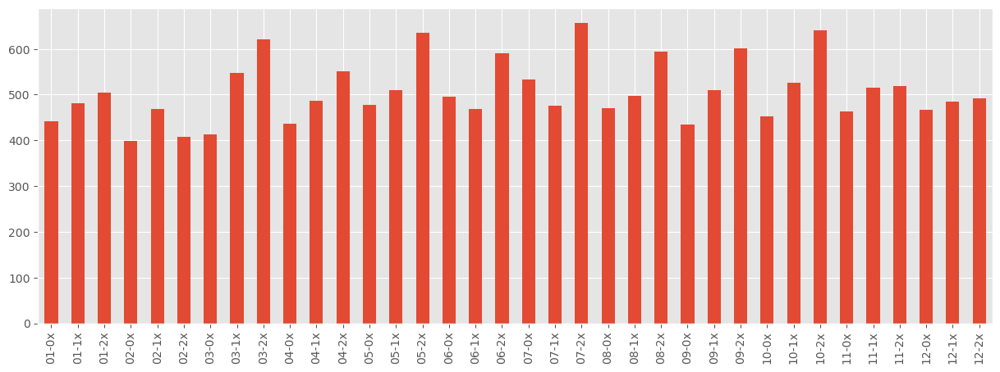

In [124]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size

date_series = df["Report_Dat"].astype('category')
date_series = date_series.value_counts().sort_index()

pandas.Series(date_series).plot.bar()
print("Crimes aggregated every ten days")

Places


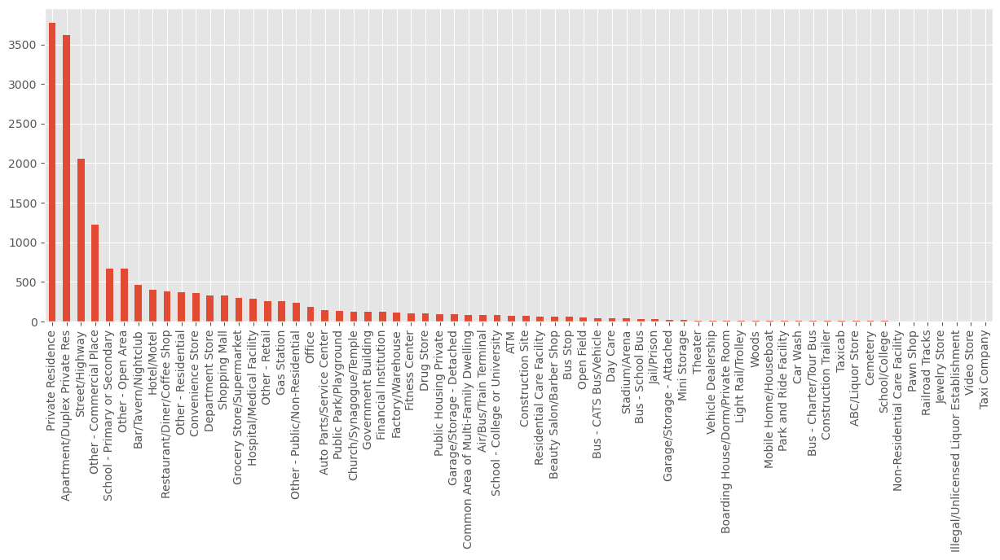

In [125]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size

crime_place = df["Place2"].astype('category')
crime_place.value_counts().plot.bar()
print("Places")

Class


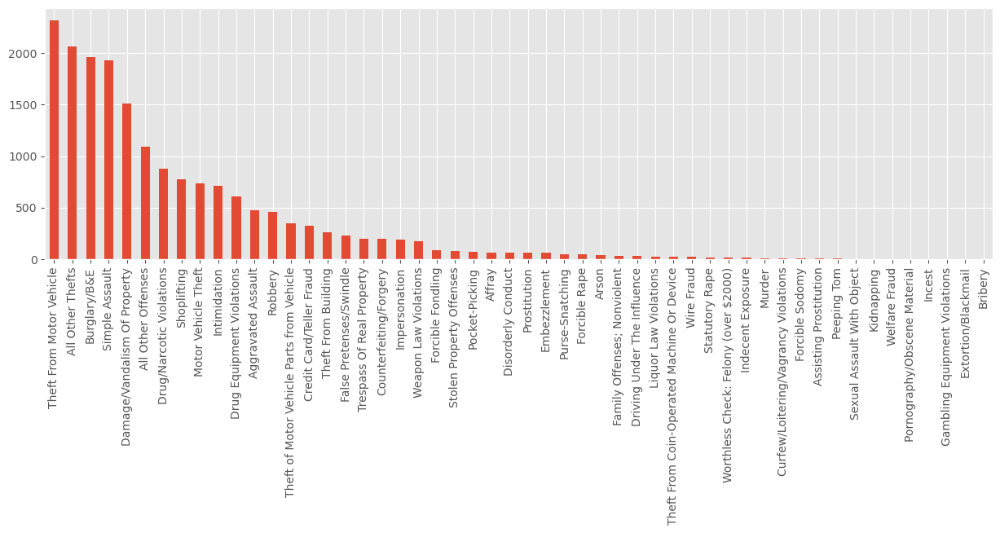

In [126]:
fig_size = [15, 4]
plt.rcParams["figure.figsize"] = fig_size

crime_class = df["NIBRSclass"].astype('category')
crime_class.value_counts().plot.bar()
print("Class")

In [127]:
df.to_csv("dataset/crimes_census_5poi.csv", sep='\t')

In [128]:
# size for each crime class
sample_size = 100
for col in df:
    df[col] = df[col].astype(object)

crimes_classes = set(df["NIBRSclass"].values)

df_sampled = pandas.DataFrame(columns=df.columns)
for cls in crimes_classes:
    oneclass_df = df[df["NIBRSclass"] == cls].reset_index(drop=True)
    sampling_indexes = oneclass_df.index.tolist()
    if len(oneclass_df) >= 100:
        sampling_indexes = numpy.random.choice(range(len(oneclass_df)), sample_size, replace=False)
    df_sampled = pandas.concat([df_sampled, oneclass_df.iloc[sampling_indexes]])

df_sampled.shape

(2929, 21)

In [129]:
df_sampled.to_csv("dataset/crimes_census_5poi_sampled100.csv", sep='\t')

Class sampled


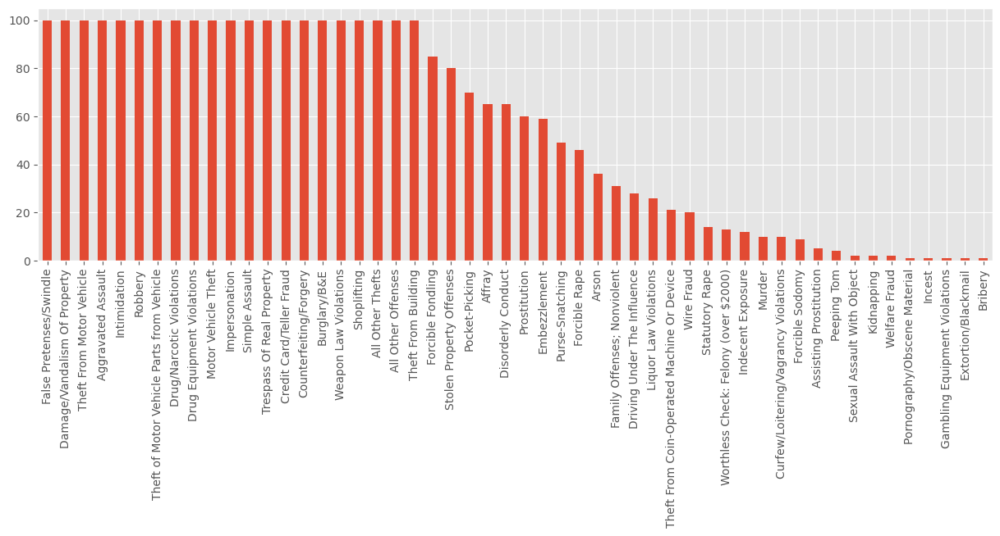

In [130]:
fig_size = [15, 4]
plt.rcParams["figure.figsize"] = fig_size

crime_class = df_sampled["NIBRSclass"].astype('category')
crime_class.value_counts().plot.bar()
print("Class sampled")

Distribution befor sampling


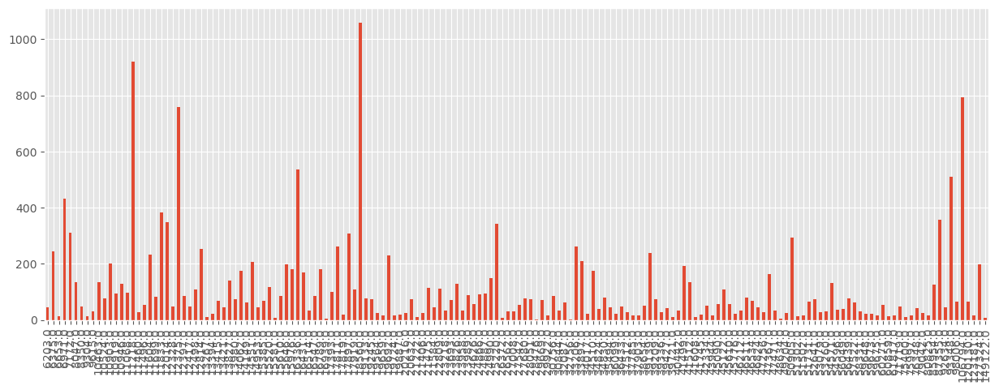

In [131]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size

date_series = df["ARPCIncome"].astype('category')
date_series = date_series.value_counts().sort_index()

pandas.Series(date_series).plot.bar()
print("Distribution befor sampling")

Crimes aggregated every ten days


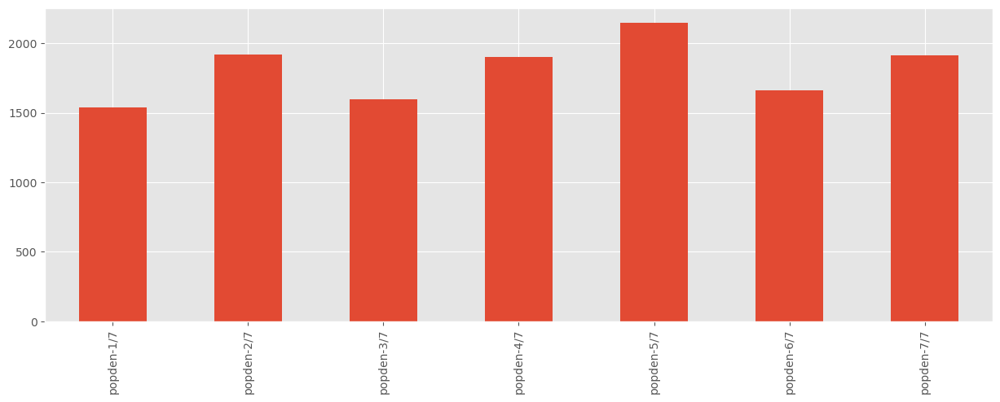

In [132]:
fig_size = [15, 5]
plt.rcParams["figure.figsize"] = fig_size

date_series = df["ARPopDen"].astype('category')
date_series = date_series.value_counts().sort_index()

pandas.Series(date_series).plot.bar()
print("Crimes aggregated every ten days")

## Modeling

In [163]:
import os
import sys
import numpy
import pandas
import matplotlib.pyplot as plt
sys.path.append(os.path.abspath("./util"))
from pymining import itemmining, assocrules
#from fp_growth import find_frequent_itemsets as get_freq_itemset

%matplotlib inline
plt.style.use('ggplot')
pandas.set_option('display.max_rows', 10000, "display.max_columns", 100)

In [164]:
#pip install fp_growth

In [165]:
to_tuple   = lambda trans_list: tuple([tuple(trans) for trans in trans_list])
# percentage = lambda x, tot=len(transactions): (x * 1.0) / tot

#function that filters the rules based on the presence of specified columns in their antecedent and/or consequent.
def only_rules_with(columns, dataframe, rules, only_cons=False):
    list_of_sets = [set(dataframe[column].values) for column in columns]
    result = []
    for rule in rules:
        current_itemset = rule[1] if only_cons else rule[0] | rule[1]
        cond = True
        for column_set in list_of_sets:
            if (current_itemset & column_set) == set():
                cond = False
        if cond:
            result.append(rule)
    return result

def print_that(filepath, rules):
    with open(filepath, 'w+') as result_file:
        for rule in rules:
            result_file.write(rule_to_string(rule))
        
def rule_to_string(rule):
    return str([j for j in rule[0]]) + "  ->  " + str([z for z in rule[1]]) + \
    ", supp: " + str(rule[2]) + \
    ", conf: " + str(rule[3]) + \
    "\n"

### Sampled Dataset

In [166]:
import pandas as pd
df = pd.read_csv("dataset/crimes_census_5poi_sampled100.csv", index_col=0, sep="\t")
df.shape

(2954, 21)

In [167]:
# without predicted values
# df = df.drop(["ARPopDen", "ARPerAA", "ARPerM1724", "ARPerSF"], axis=1)
df = df.drop(["BLOCKID10", "Street_Nam", "ARPerRMI5L", "ARPer3MU", "ARHeteInx", "ARPerHOwn"], axis=1)
df = df.drop(["First_POI", "Second_POI", "Third_POI", "Fourth_POI", "Fifth_POI"], axis=1)
transactions = [row.tolist() for i, row in df.iterrows()]

print(df.shape)
df.describe()

(2954, 10)


,ARPCIncome,ARPerHEdu,ARPerWork,ARPopDen,ARPerAA,ARPerM1724,ARPerSF,NIBRSclass,Place2,Report_Dat
count,2954,2954,2954,2954,2954,2954,2954,2954,2954,2954
unique,7,7,7,7,7,7,7,52,60,36
top,inc-1/7,edu-4/7,empl-1/7,popden-5/7,afro-1/7,youngm-4/7,sinpar-6/7,Credit Card/Teller Fraud,Private Residence,07-2x
freq,528,482,590,535,596,678,585,100,511,109


### Frequent Itemset generation

In [168]:
min_supp = 10

#### Relim
[Paper 1](https://pdfs.semanticscholar.org/cb3e/76d1773d08545f21daf28cc87b051604aa95.pdf)
[Paper 2](http://www.borgelt.net/papers/relim.pdf)

In [169]:
%%time
# using the  RElim algorithm to find the frequent itemsets with min_support 10 
relim_input = itemmining.get_relim_input(to_tuple(transactions))
relim_itemsets = itemmining.relim(relim_input, min_support=min_supp)
print ("number of frequent itemsets", len(relim_itemsets), "\n")

number of frequent itemsets 21140 

CPU times: user 382 ms, sys: 34.2 ms, total: 417 ms
Wall time: 535 ms


### Rules generation

In [170]:
min_conf = 0.60

In [171]:
%%time
rules = assocrules.mine_assoc_rules(relim_itemsets, min_support=min_supp, min_confidence=min_conf)
print(len(rules))

175934
CPU times: user 2.96 s, sys: 2.22 s, total: 5.18 s
Wall time: 9.07 s


#### Filtering the rules
leaving only rules that have crimes or that have crime in consequent (RHS)

In [173]:
rules_with_crimes = only_rules_with(["NIBRSclass"], df, rules)
print("# of rules with crimes:", len(rules_with_crimes))
rules_with_crimes_in_cons = only_rules_with(["NIBRSclass"], df, rules, only_cons=True)
print("# of rules with crimes in consequent:", len(rules_with_crimes_in_cons))

# of rules with crimes: 48218
# of rules with crimes in consequent: 4173


In [175]:
# printing some rules
for rule in rules_with_crimes_in_cons[:2]:
    print(rule_to_string(rule))

['ATM', 'edu-7/7', 'sinpar-5/7', 'empl-1/7']  ->  ['youngm-7/7', 'popden-2/7', 'afro-6/7', 'inc-1/7', 'Credit Card/Teller Fraud'], supp: 10, conf: 1.0

['ATM', 'sinpar-5/7', 'empl-1/7']  ->  ['youngm-7/7', 'popden-2/7', 'inc-1/7', 'afro-6/7', 'Credit Card/Teller Fraud', 'edu-7/7'], supp: 10, conf: 1.0



### Entire dataset

In [181]:
df_entire = pandas.read_csv("./dataset/crimes_census_5poi.csv", index_col=0, sep="\t")
df_entire.shape

(19106, 21)

In [182]:
# without predicted values
# df_entire = df_entire.drop(["ARPopDen", "ARPerAA", "ARPerM1724", "ARPerSF"], axis=1)
df_entire = df_entire.drop(["BLOCKID10", "Street_Nam", "ARHeteInx", "ARPerHOwn", 
                            "ARPerRMI5L", "ARPer3MU"], axis=1)
df_entire = df_entire.drop(["First_POI", "Second_POI", "Third_POI", "Fourth_POI", "Fifth_POI"], axis=1)
transactions_entire = [row.tolist() for i, row in df_entire.iterrows()]

print(df.shape)
df.describe()

(2954, 10)


,ARPCIncome,ARPerHEdu,ARPerWork,ARPopDen,ARPerAA,ARPerM1724,ARPerSF,NIBRSclass,Place2,Report_Dat
count,2954,2954,2954,2954,2954,2954,2954,2954,2954,2954
unique,7,7,7,7,7,7,7,52,60,36
top,inc-1/7,edu-4/7,empl-1/7,popden-5/7,afro-1/7,youngm-4/7,sinpar-6/7,Credit Card/Teller Fraud,Private Residence,07-2x
freq,528,482,590,535,596,678,585,100,511,109


In [183]:
min_supp = 70

In [184]:
%time
relim_input_entire = itemmining.get_relim_input(to_tuple(transactions_entire))
relim_itemsets_entire = itemmining.relim(relim_input_entire, min_support=min_supp)
print("number of frequent itemsets", len(relim_itemsets_entire), "\n")

CPU times: user 5 µs, sys: 1e+03 ns, total: 6 µs
Wall time: 30.3 µs
number of frequent itemsets 17086 



In [185]:
min_conf = 0.60

In [186]:
%%time
rules_entire = assocrules.mine_assoc_rules(relim_itemsets_entire, min_support=min_supp, min_confidence=min_conf)
print(len(rules_entire))

101352
CPU times: user 1.63 s, sys: 993 ms, total: 2.62 s
Wall time: 4.39 s


In [188]:
rules_with_crimes_entire = only_rules_with(["NIBRSclass"], df_entire, rules_entire)
print("# of rules with crimes:", len(rules_with_crimes_entire))
rules_with_crimes_in_cons_entire = only_rules_with(["NIBRSclass"], df_entire, rules_entire, only_cons=True)
print("# of rules with crimes in consequent:", len(rules_with_crimes_in_cons_entire))

# of rules with crimes: 23332
# of rules with crimes in consequent: 1461


In [190]:
for rule in rules_with_crimes_in_cons_entire[:3]:
    print(rule_to_string(rule))

['sinpar-2/7', 'Department Store']  ->  ['inc-6/7', 'youngm-1/7', 'edu-4/7', 'popden-1/7', 'empl-6/7', 'afro-1/7', 'Shoplifting'], supp: 78, conf: 0.8210526315789474

['afro-1/7', 'sinpar-2/7', 'Department Store']  ->  ['inc-6/7', 'youngm-1/7', 'edu-4/7', 'popden-1/7', 'empl-6/7', 'Shoplifting'], supp: 78, conf: 0.8297872340425532

['sinpar-2/7', 'edu-4/7', 'Department Store']  ->  ['inc-6/7', 'youngm-1/7', 'popden-1/7', 'empl-6/7', 'afro-1/7', 'Shoplifting'], supp: 78, conf: 0.8387096774193549



### Evaluation

In [191]:
# calculate lift using rule support, antecedent support, and consequent support
def lift(rule_supp, ant_supp, cons_supp):
    return (rule_supp / 1.0) / (ant_supp * cons_supp)
# Function to calculate conviction using consequent support and rule confidence
def conviction(cons_supp, rule_conf):
    return (1.0 - cons_supp) / (1.0 - rule_conf)

In [199]:
for rule in rules:
    l = lift(relim_itemsets[rule[0] | rule[1]], relim_itemsets[rule[0]], relim_itemsets[rule[1]])
    if l > 1:
        print(l)
    #c = conviction(relim_itemsets[rule[1]], rule[3])

# High utility pattern mining

### Based on this explanation from the PAMI website, describe the outputs of the high utility pattern mining algorithms. Explain how internal and external utilities materialize in the outputs ? What do they mean ?
* The output of a high utility pattern mining algorithm is a set of high utility frequent patterns that satisfy the user-specified minimum utility (minUtil) and minimum support (minSup) thresholds. The discovered patterns are presented in a readable format for users to interpret and understand.
* Internal and external utilities are two key measures in high utility pattern mining algorithms.

* Internal utility measures the utility of an itemset without considering the presence of any other itemsets in the dataset. It represents how valuable an itemset is on its own. Internal utility is typically calculated using a local measure such as the sum or average of the utility values of individual transactions in which the itemset occurs.

* External utility, on the other hand, considers the interaction between itemsets. It measures the utility of an itemset in the context of other itemsets in the dataset. External utility takes into account the fact that the utility of an itemset may change depending on the presence or absence of other itemsets in the same transaction. External utility is usually calculated using a global measure such as the difference between the utility of an itemset and the utility of its complement (the set of all other itemsets).

* The outputs of high utility pattern mining algorithms typically include itemsets that have high internal and/or external utilities. Itemsets with high internal utility are considered to be valuable on their own, while itemsets with high external utility are valuable in the context of other itemsets.


### Based on the introduction of Islam, M.A., Rafi, M.R., Azad, Aa. et al. Weighted frequent sequential pattern mining. Appl Intell 52, 254–281 (2022). https://doi.org/10.1007/s10489-021-02290-w, explain why weighted Frequent Pattern Mining is important. Find inspiration from the comic book example they provide to make an explanation of your own.

Based on the introduction of the article, weighted frequent pattern mining is important because it allows for the discovery of patterns that occur frequently and have high importance or impact on the data, as determined by weights associated with each item in the data. In many real-world applications, the frequency of occurrence of an item may not be the sole indicator of its importance or relevance. For example, in a retail transaction dataset, the purchase of an expensive item such as a television may have a higher impact on sales revenue compared to the purchase of a cheaper item like a candy bar, even if the latter occurs more frequently.

By incorporating item weights into frequent pattern mining, the authors argue that their approach can improve the relevance and usefulness of the discovered patterns, particularly in domains such as healthcare, finance, and marketing. For example, in healthcare, the frequency of a particular symptom may not necessarily indicate its severity or importance, while in finance, the value of a stock may be a more important factor than its trading volume in identifying profitable trading strategies. Therefore, by considering item weights in frequent pattern mining, the discovered patterns can provide more meaningful insights and support decision-making in various domains.

A supermarket chain can use weighted frequent pattern mining to analyze customer purchase data and identify popular product combinations. This information can be used to optimize store layout and product placement to increase sales. Additionally, this technique can also help identify products that are frequently purchased together but may not be located near each other in the store. By placing these products closer together, the supermarket chain can increase the likelihood of customers purchasing them together, leading to increased sales and revenue.

# Process mining

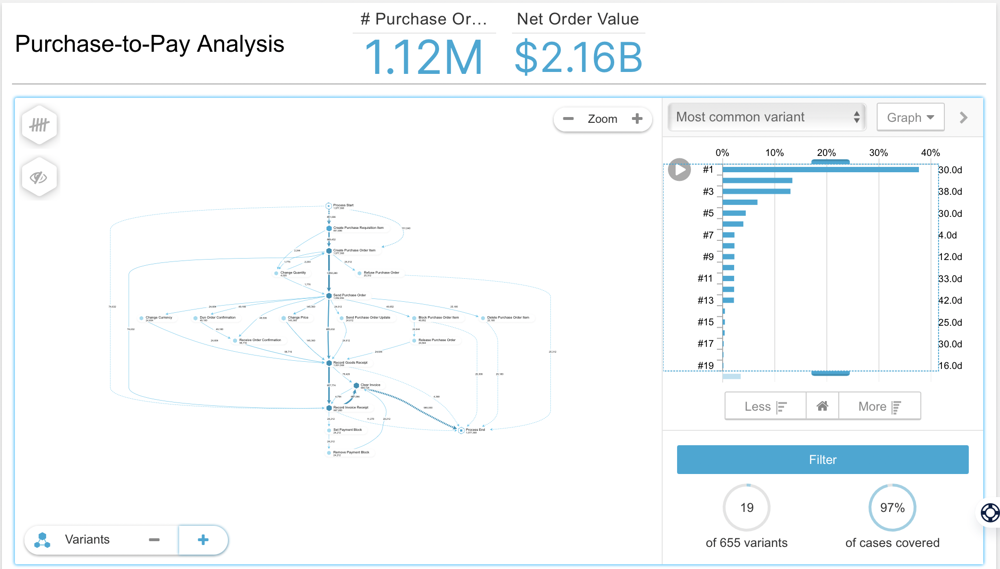

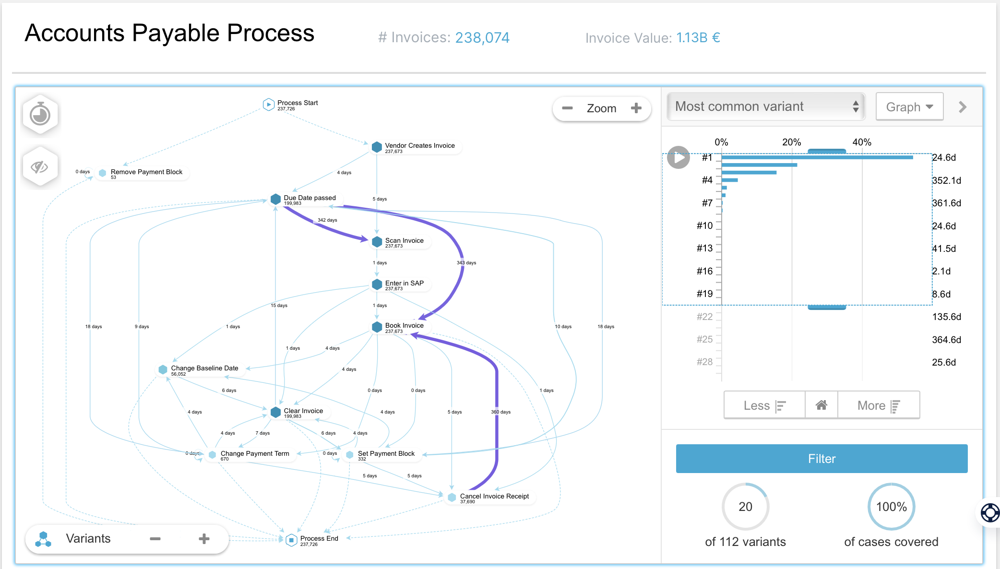